In [1]:
# Julia Chancey
# CIS 4930 Multimodal ML
# Spring 2023
# Homework 3
# Audio Classification of 4 emotions

In [86]:
# imports ordered alphabetically
import librosa.display
import matplotlib
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import make_axes_locatable
import os
import random
import shutil

In [12]:
# STEP 1: SPLIT DATASET INTO TRAINING AND TESTING SETS

In [3]:
# get directory
currDir = os.getcwd()
dataDir = os.path.join(currDir, "data")

In [4]:
print(dataDir)

/Users/julia/cis4930-mulitmodal-ml/hw3/data


In [5]:
# categories of emotions
emotions = ["angry", "fear", "happy", "sad"]

In [8]:
# go through each emotion dataset
for emotion in emotions:
    emotionDir = os.path.join(dataDir, emotion)
    
    # get list of all files within dataset for random selection
    files = os.listdir(emotionDir)
    trainFiles = random.sample(files, 70)
    
    # move copy of file into train or test folder
    for file in files:
        source = os.path.join(emotionDir, file)
        
        if file in trainFiles:
            destination = os.path.join(dataDir, "train", emotion)
        else:
            destination = os.path.join(dataDir, "test", emotion)
            
        path = os.path.join(destination, file)
        
        os.makedirs(destination, exist_ok=True)
        
        shutil.copy(source, path)

In [13]:
# STEP 2: EXPLORATORY DATA ANALYSIS

In [18]:
# sample audio files for visualization
trainDir = os.path.join(dataDir, "train")
testDir = os.path.join(dataDir, "test")

angryTrainDir = os.path.join(trainDir, "angry")
angryTestDir = os.path.join(testDir, "angry")

fearTrainDir = os.path.join(trainDir, "fear")
fearTestDir = os.path.join(testDir, "fear")

happyTrainDir = os.path.join(trainDir, "happy")
happyTestDir = os.path.join(testDir, "happy")

sadTrainDir = os.path.join(trainDir, "sad")
sadTestDir = os.path.join(testDir, "sad")

angryTrainSample = random.sample(os.listdir(angryTrainDir), 5)
angryTestSample = random.sample(os.listdir(angryTestDir), 5) 

fearTrainSample = random.sample(os.listdir(fearTrainDir), 5)
fearTestSample = random.sample(os.listdir(fearTestDir), 5) 

happyTrainSample = random.sample(os.listdir(happyTrainDir), 5)
happyTestSample = random.sample(os.listdir(happyTestDir), 5) 

sadTrainSample = random.sample(os.listdir(sadTrainDir), 5)
sadTestSample = random.sample(os.listdir(sadTestDir), 5) 

In [19]:
print(angryTrainSample)

['YAF_page_angry.wav', 'YAF_which_angry.wav', 'YAF_talk_angry.wav', 'YAF_rose_angry.wav', 'YAF_pole_angry.wav']


In [75]:
def plotData(audio_dataset, path):   
    for audio in audio_dataset:
        file_path = os.path.join(path, audio)
        
        # load the audio file
        audio_data, audio_sr = librosa.load(file_path)

        # compute the spectrogram
        spectrogram = librosa.stft(audio_data)
        spectrogram_db = librosa.amplitude_to_db(abs(spectrogram))

        # plot the spectrogram
        plt.figure(figsize=(10, 4))
        librosa.display.specshow(spectrogram_db, sr=audio_sr, x_axis='time', y_axis='hz')
        plt.title('Spectrogram')
        plt.show()

In [76]:
for file_name in angryTrainSample:
    print(file_name)

YAF_page_angry.wav
YAF_which_angry.wav
YAF_talk_angry.wav
YAF_rose_angry.wav
YAF_pole_angry.wav


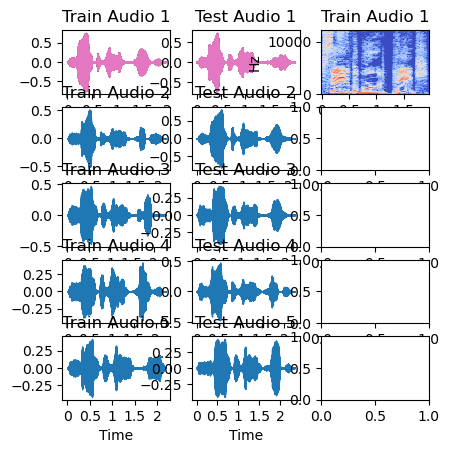

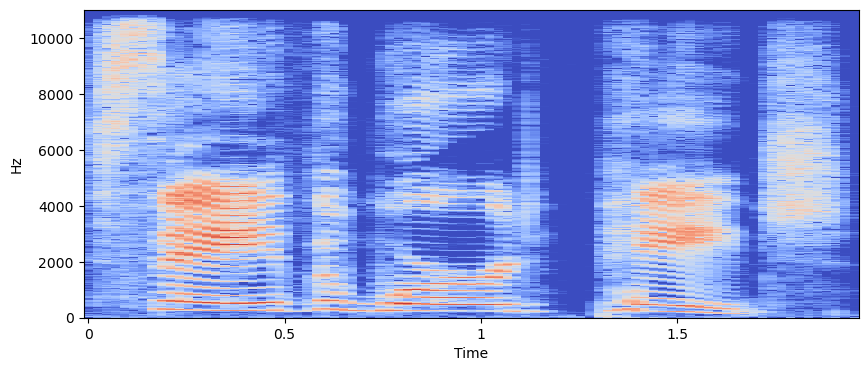

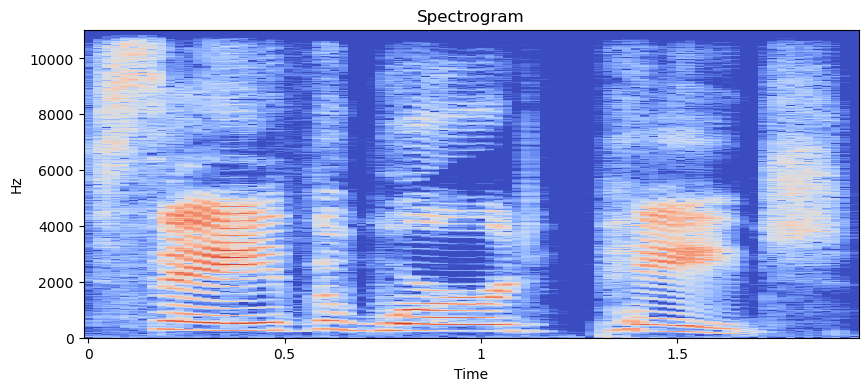

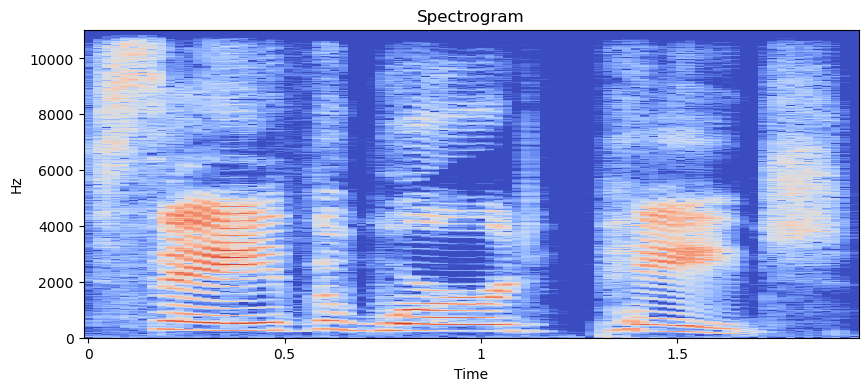

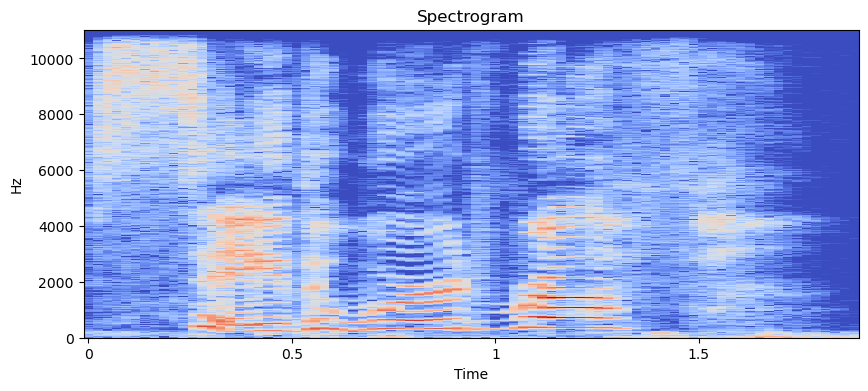

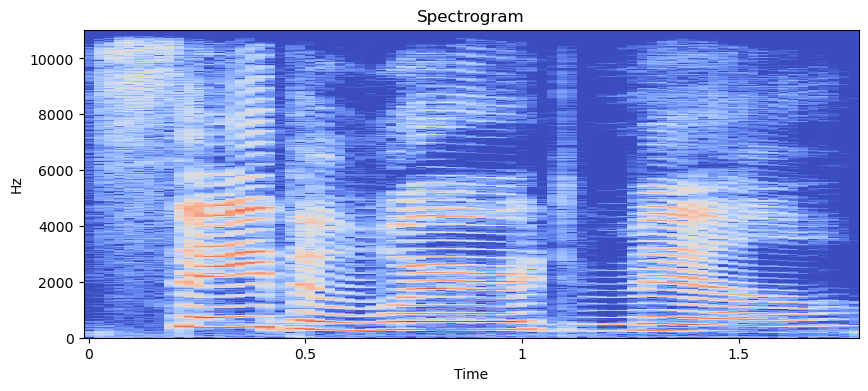

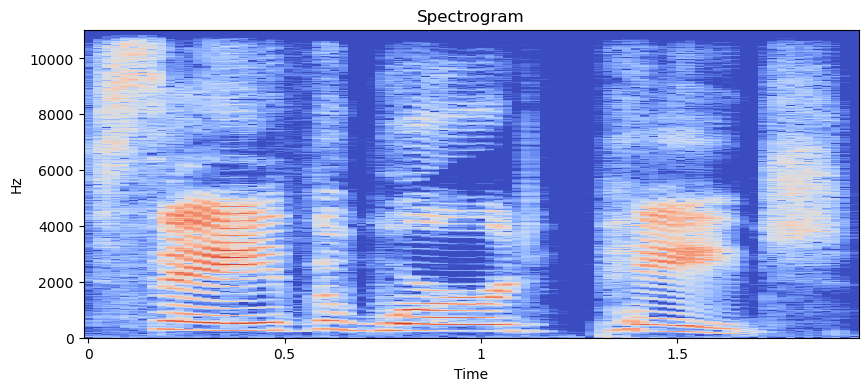

AttributeError: module 'matplotlib' has no attribute 'pyplot'

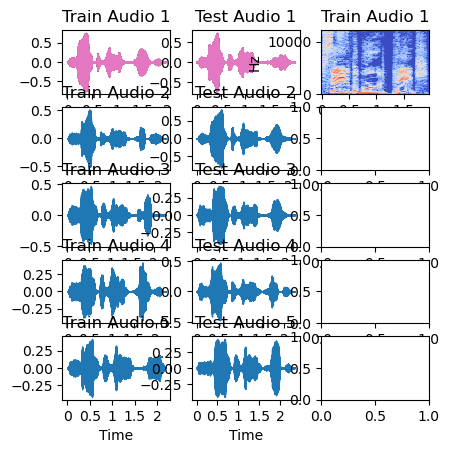

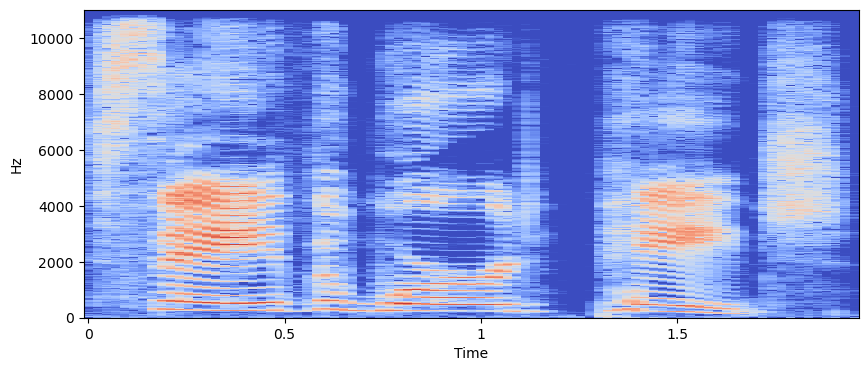

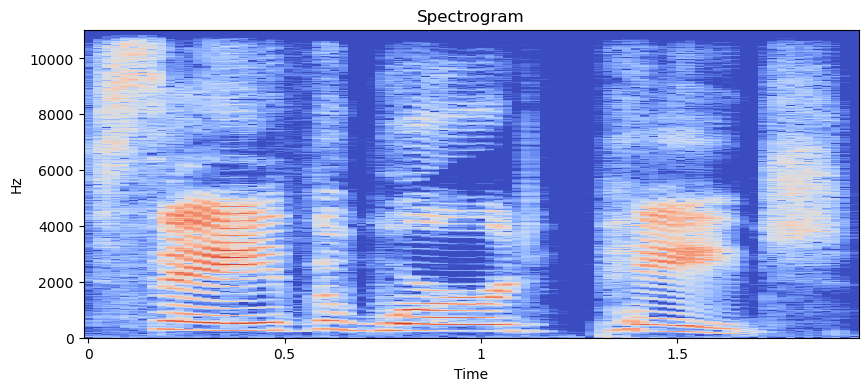

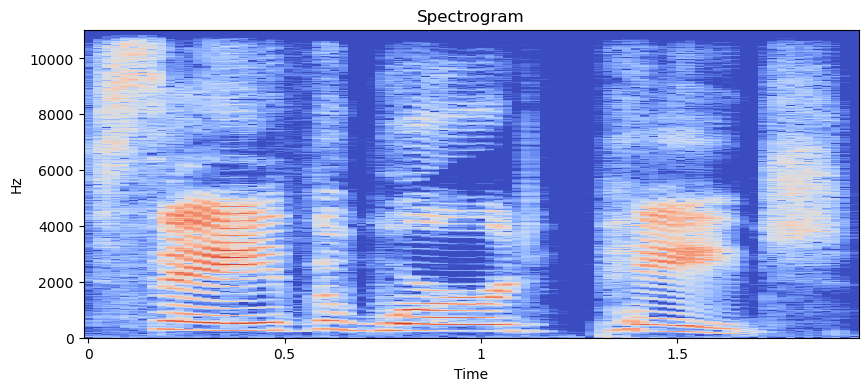

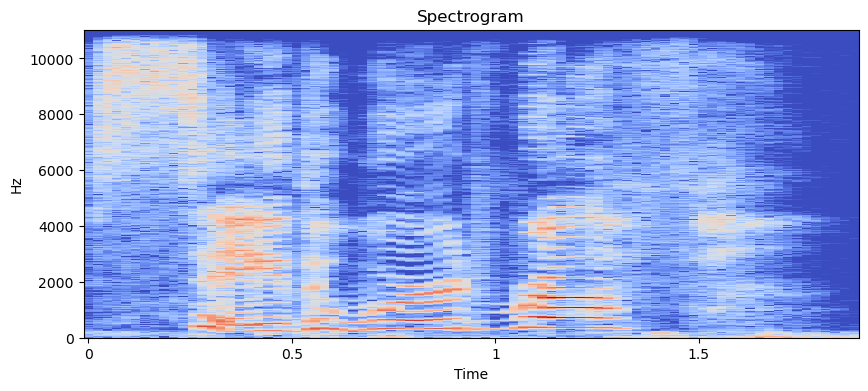

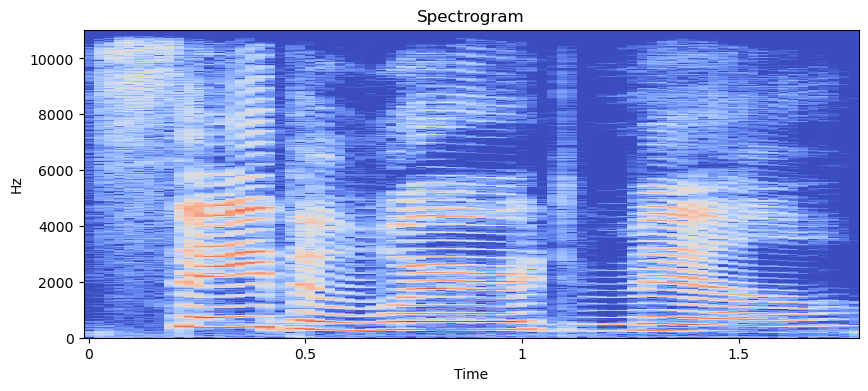

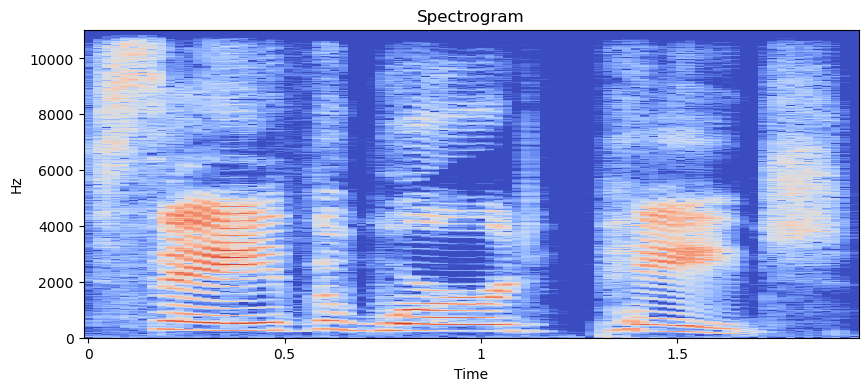

AttributeError: module 'matplotlib' has no attribute 'pyplot'

In [77]:
plotData(angryTrainSample, angryTrainDir)

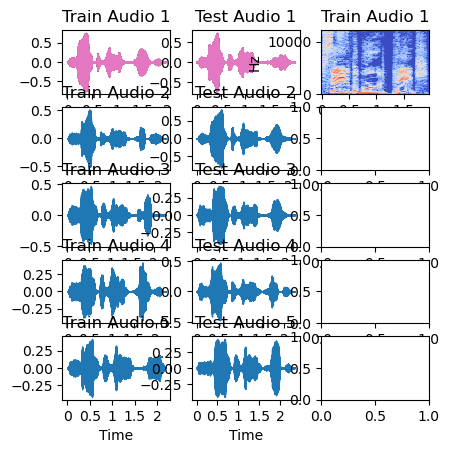

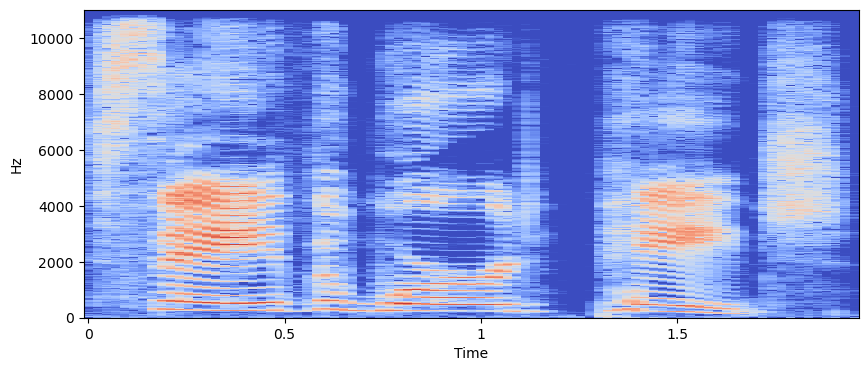

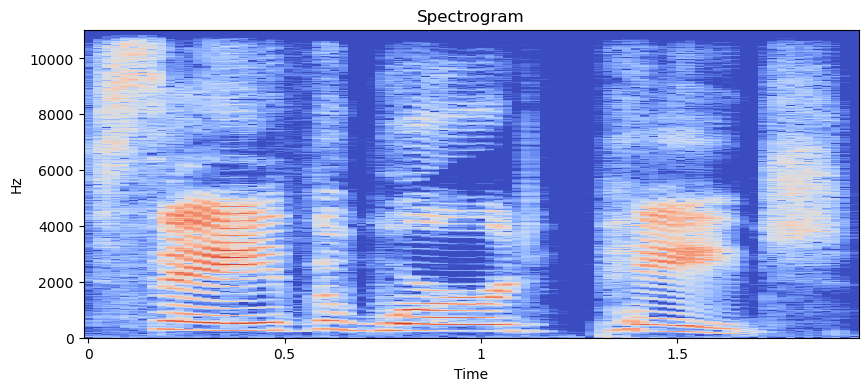

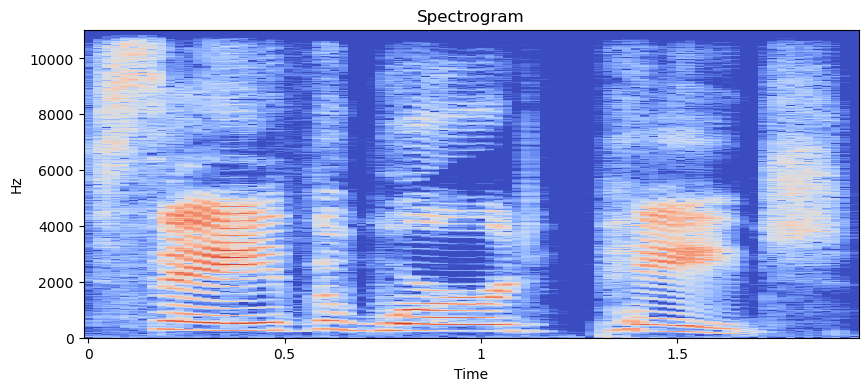

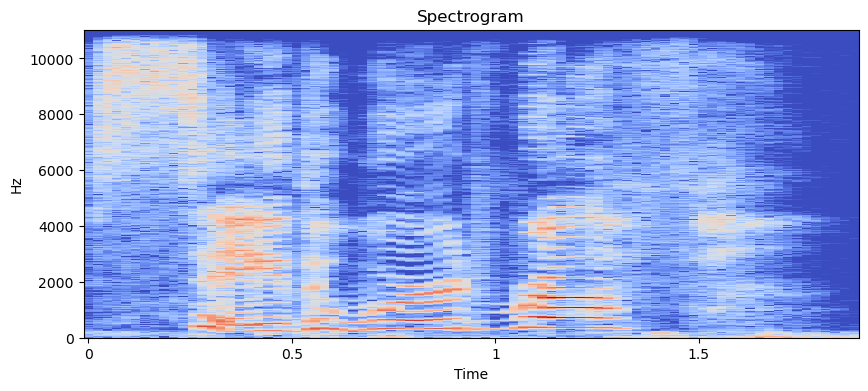

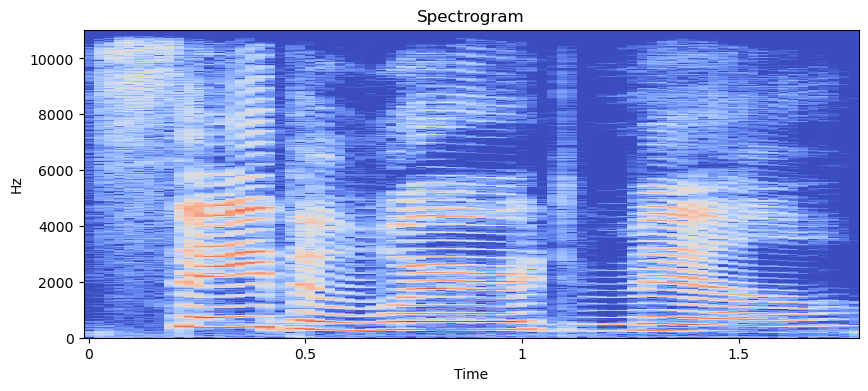

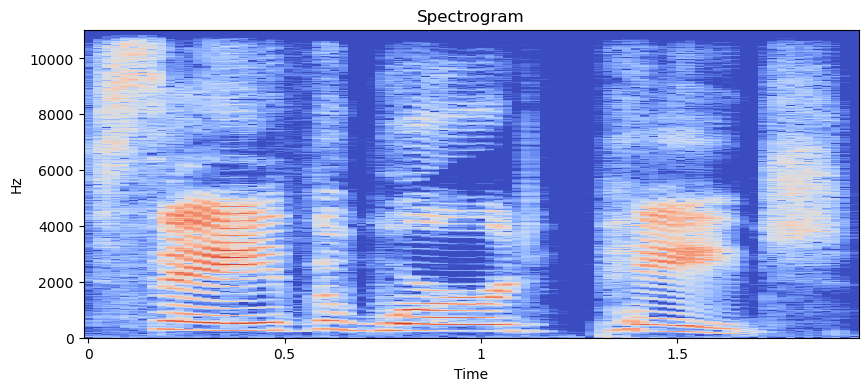

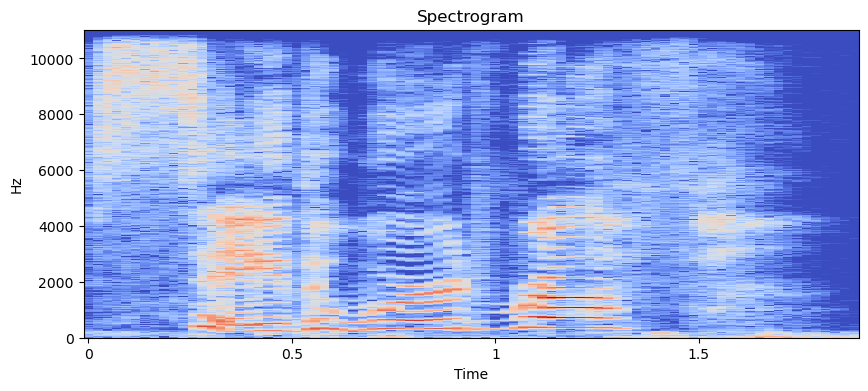

AttributeError: module 'matplotlib' has no attribute 'pyplot'

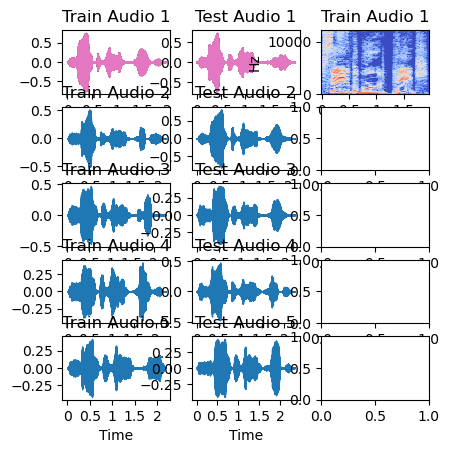

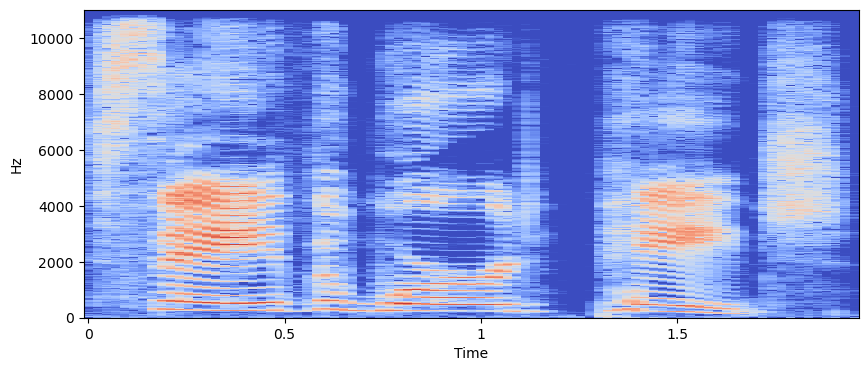

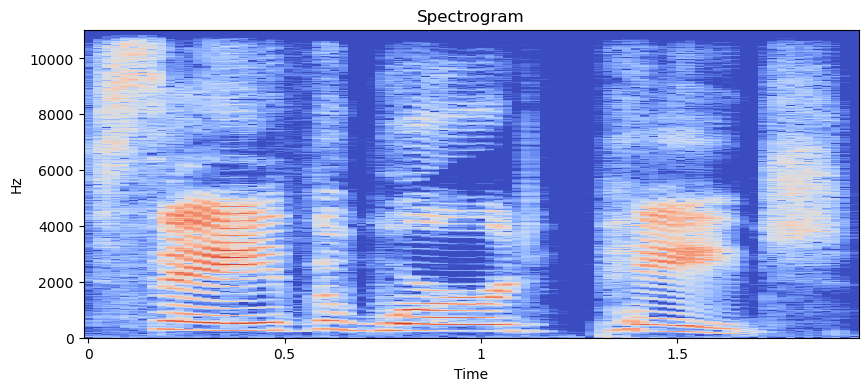

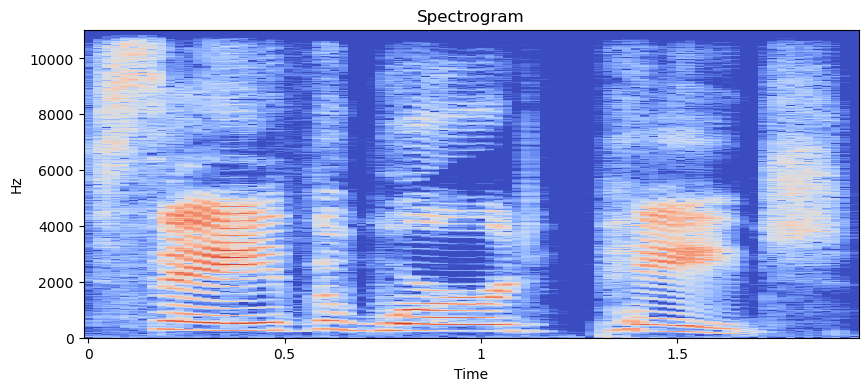

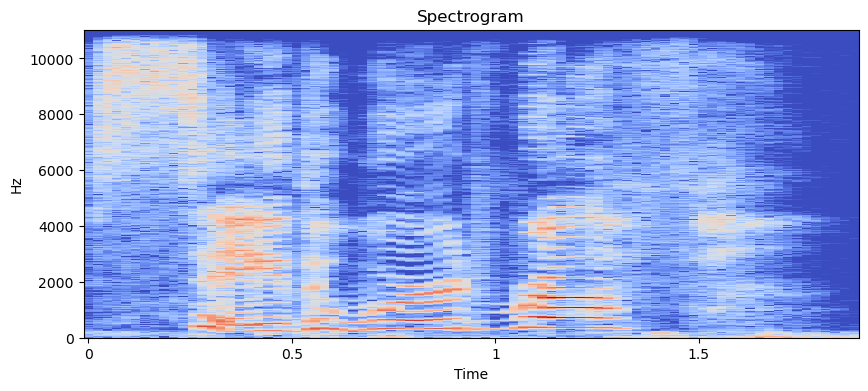

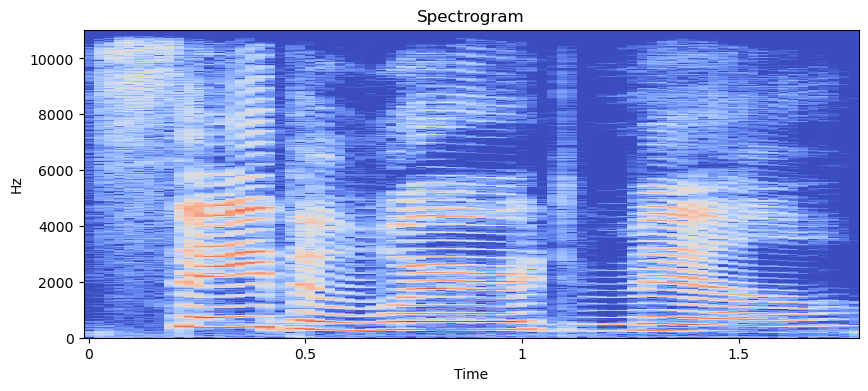

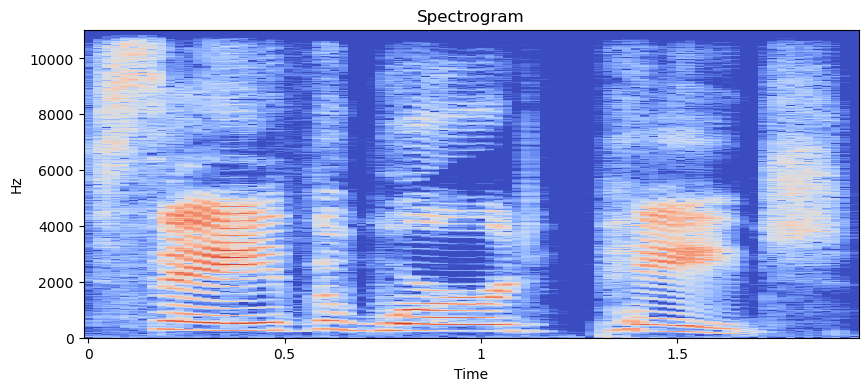

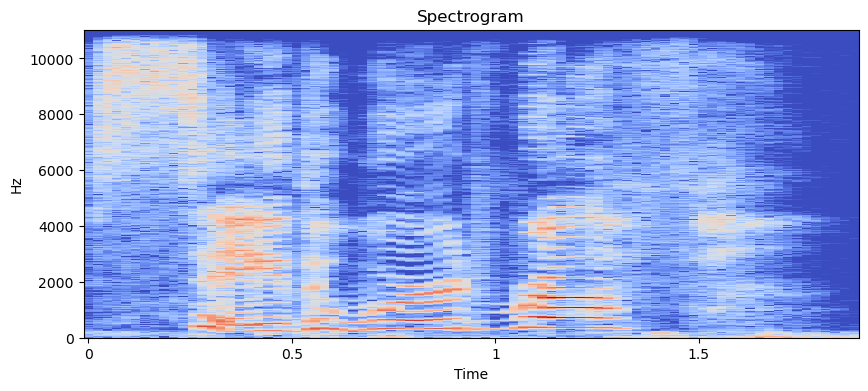

AttributeError: module 'matplotlib' has no attribute 'pyplot'

In [78]:
plotData(fearTrainSample, fearTrainDir)

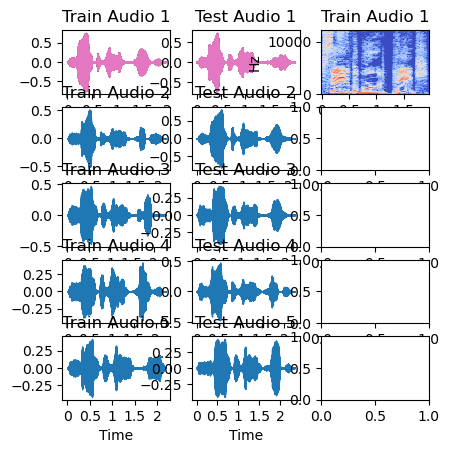

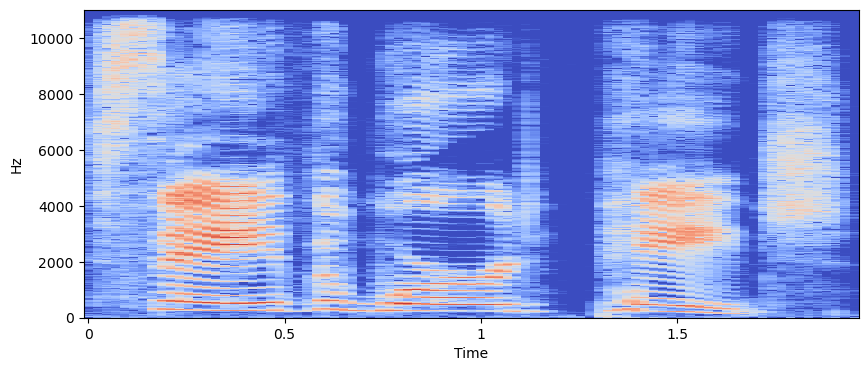

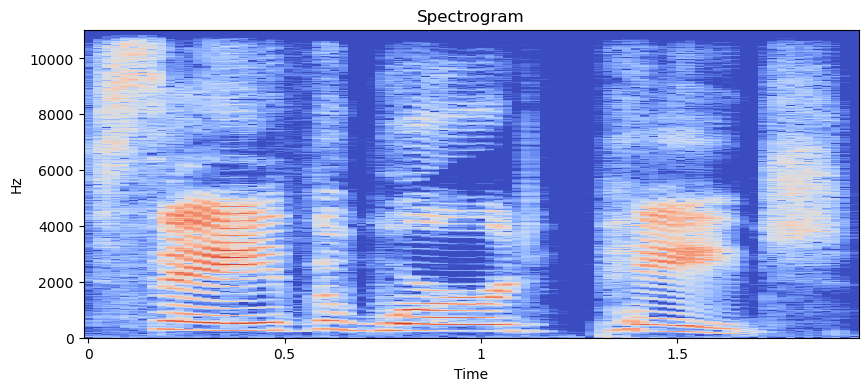

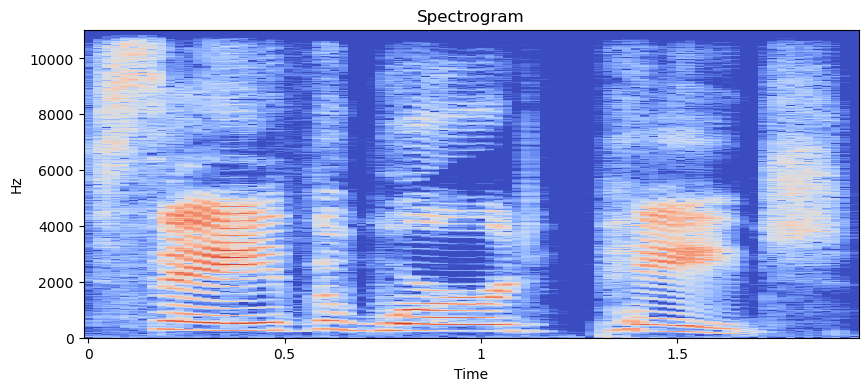

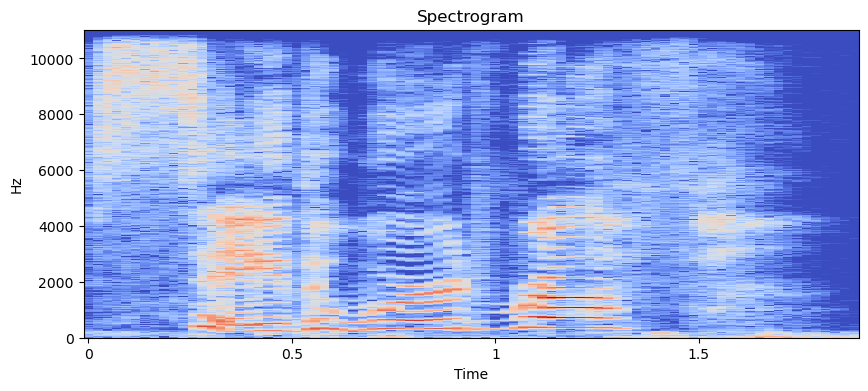

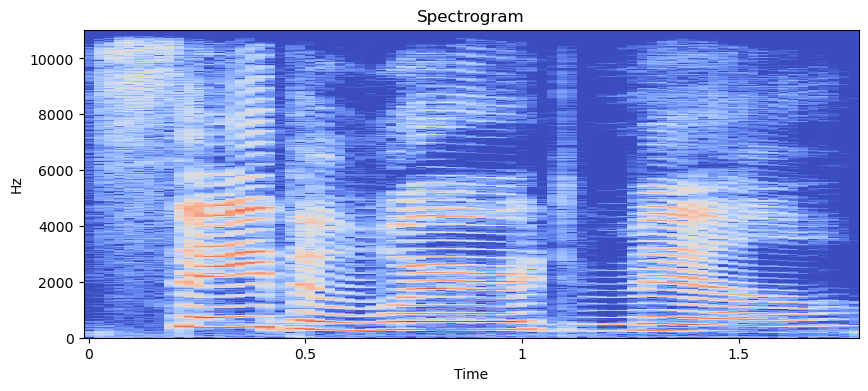

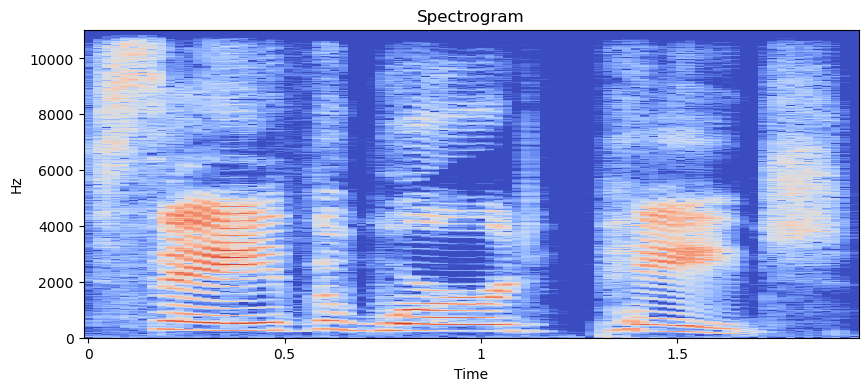

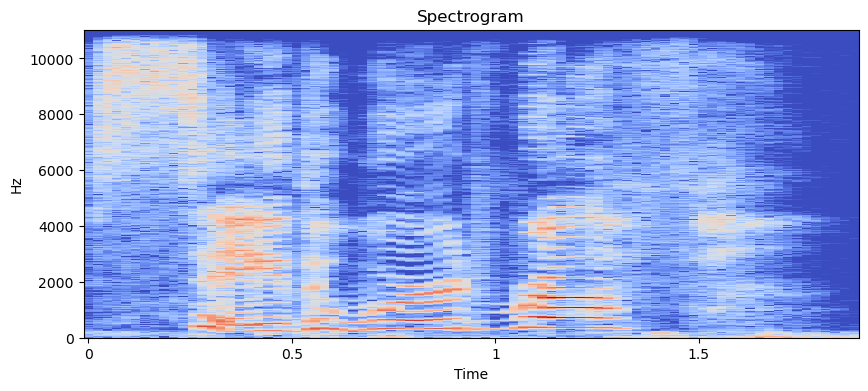

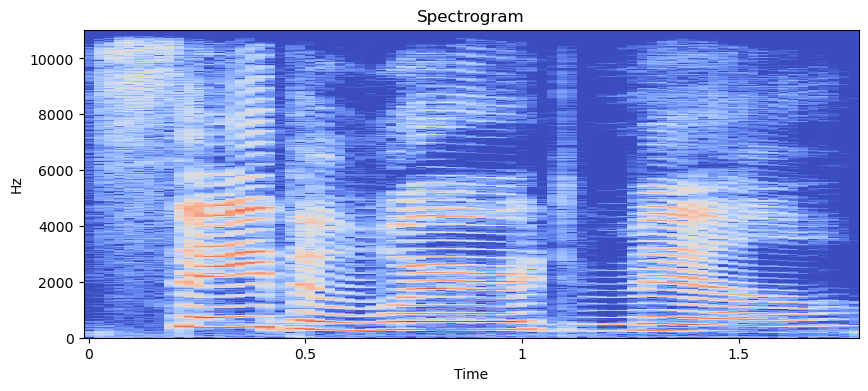

AttributeError: module 'matplotlib' has no attribute 'pyplot'

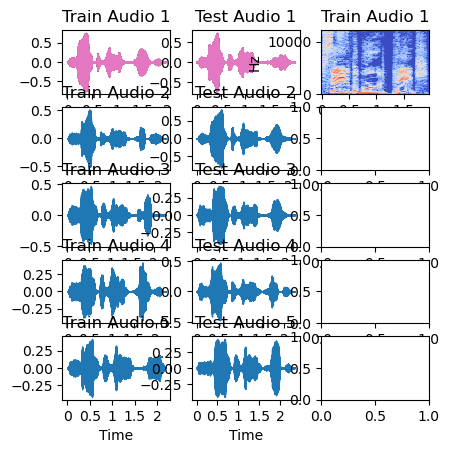

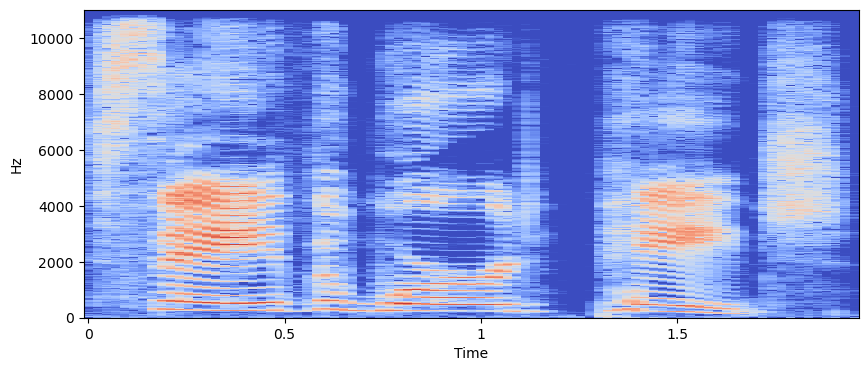

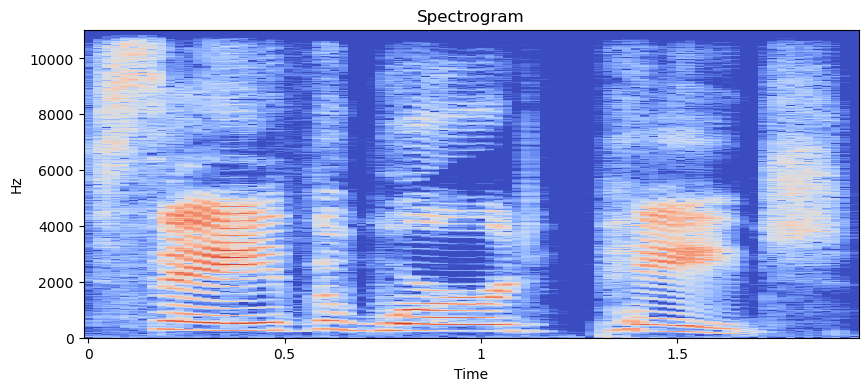

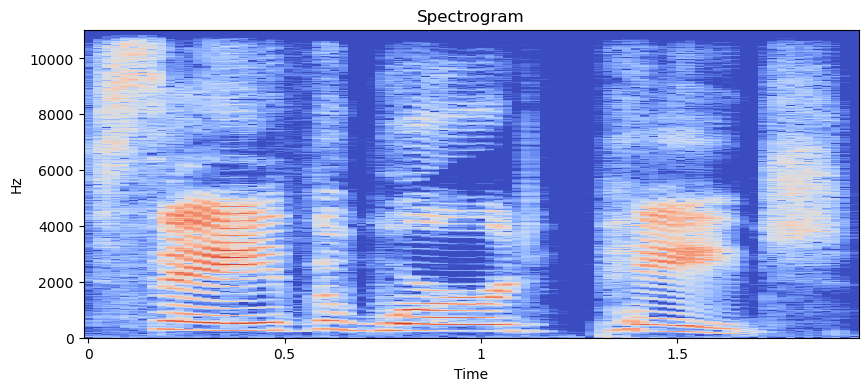

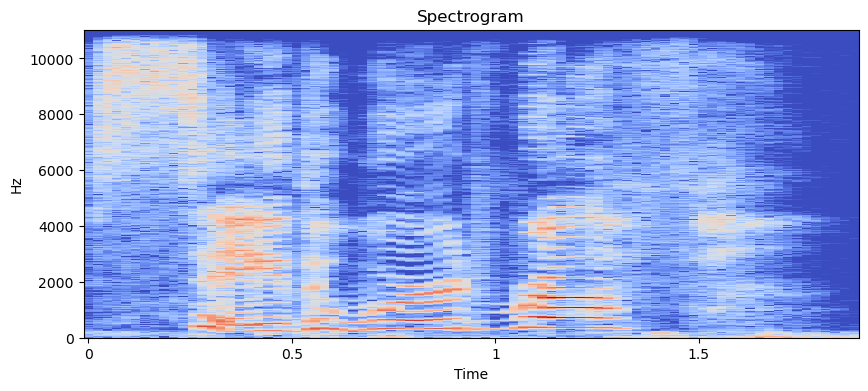

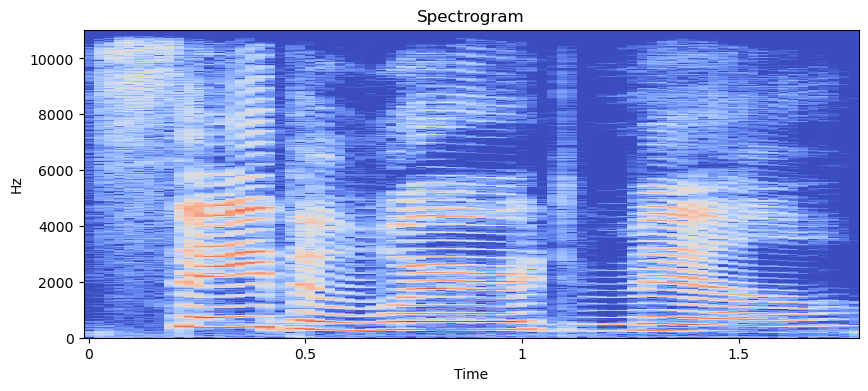

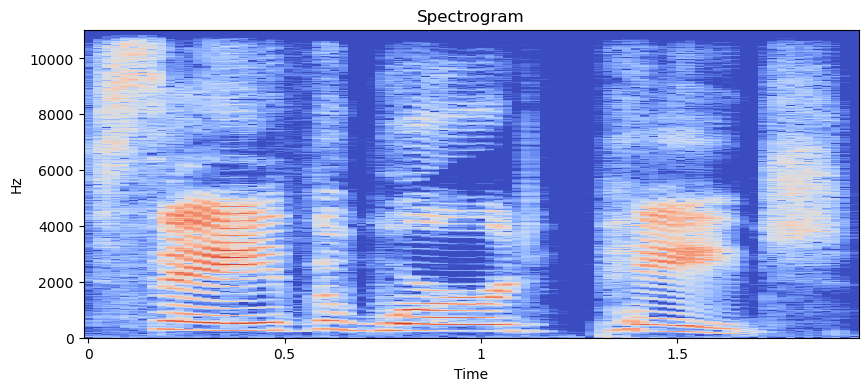

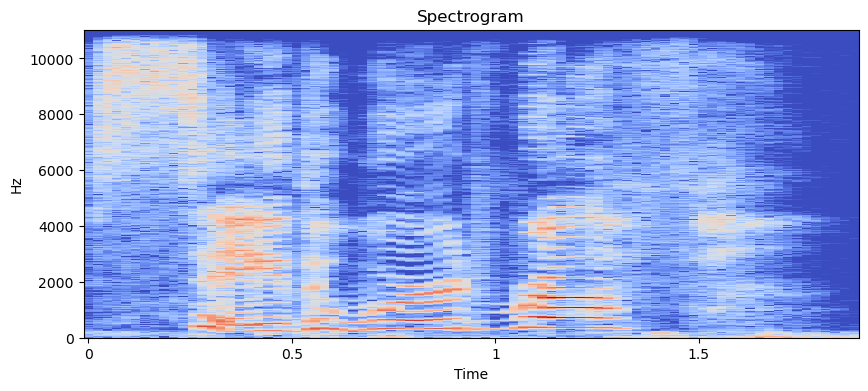

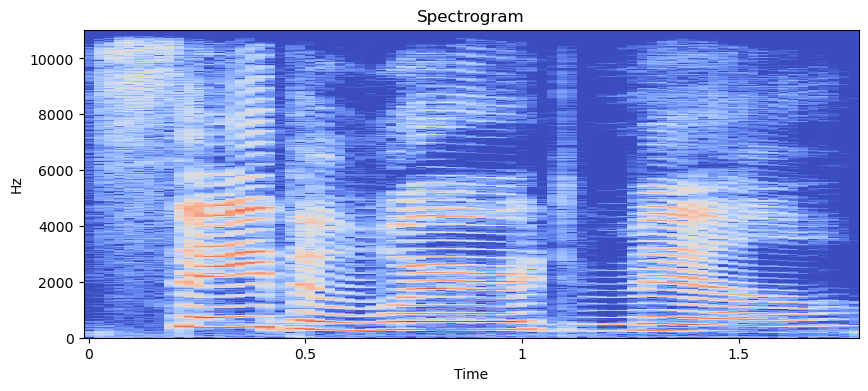

AttributeError: module 'matplotlib' has no attribute 'pyplot'

In [79]:
plotData(happyTrainSample, happyTrainDir)

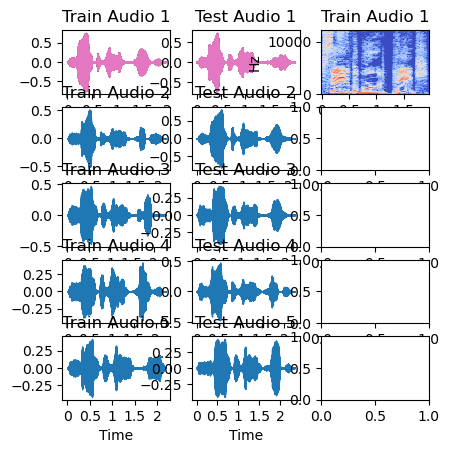

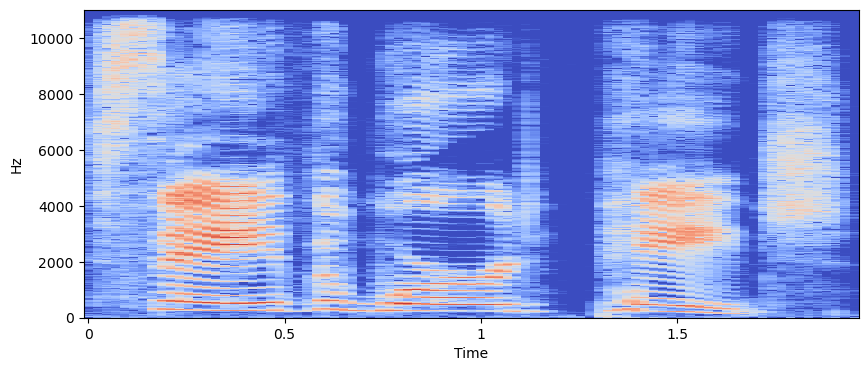

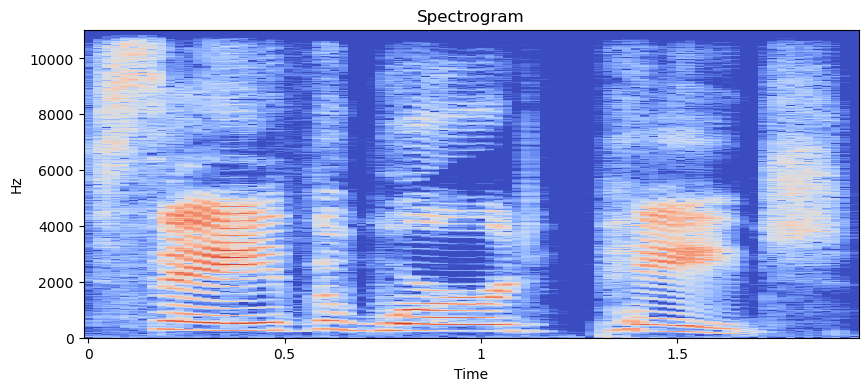

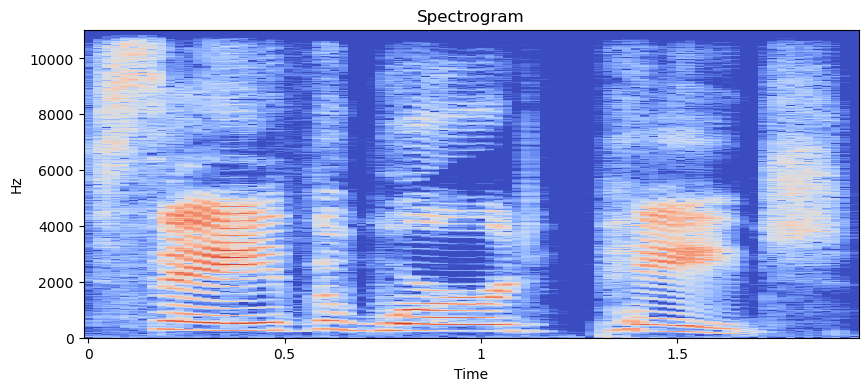

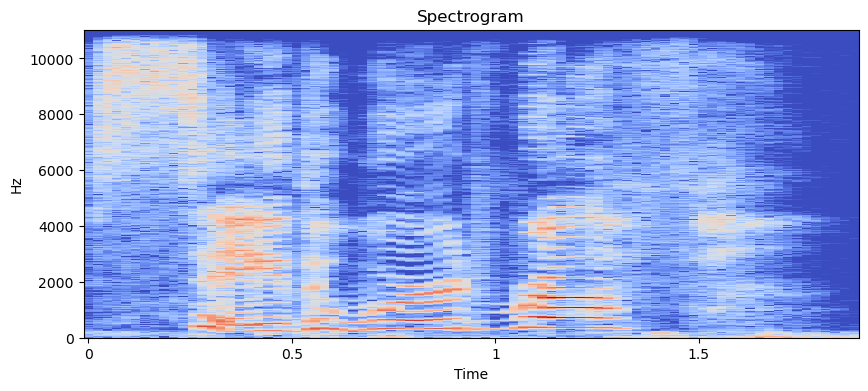

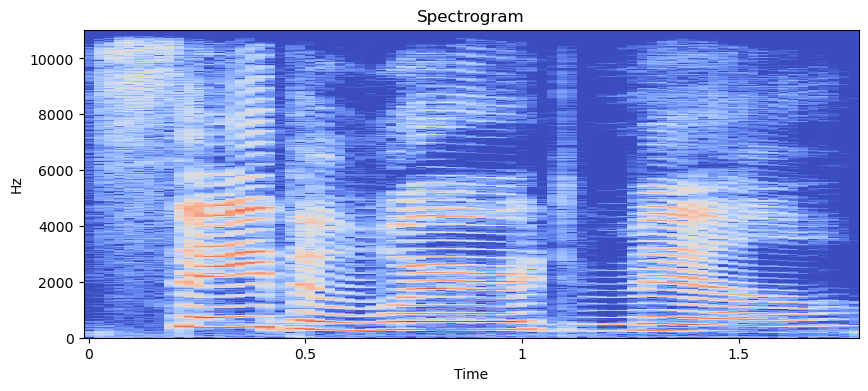

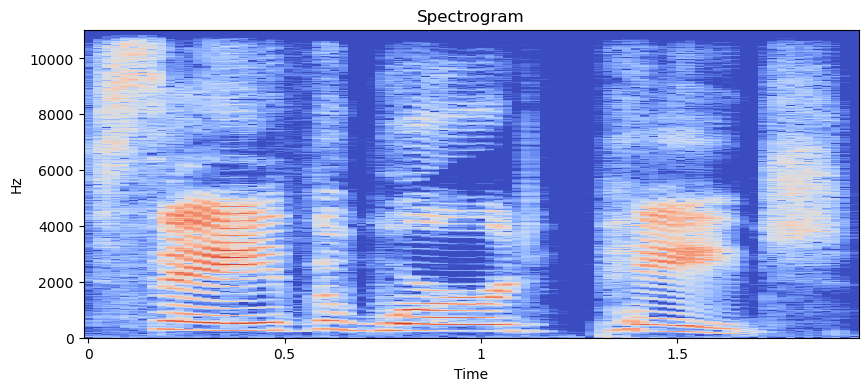

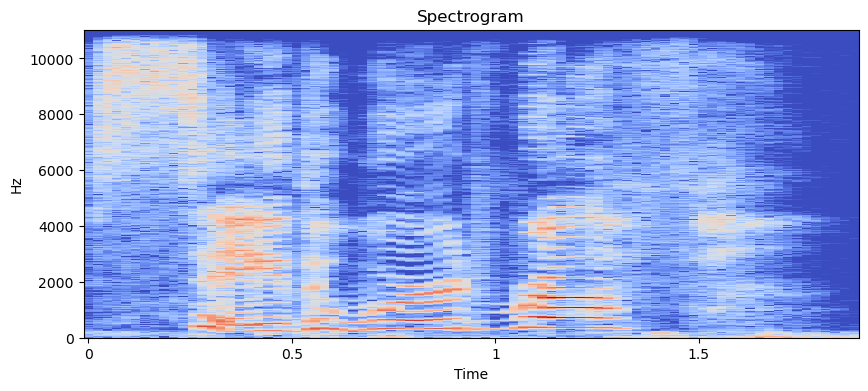

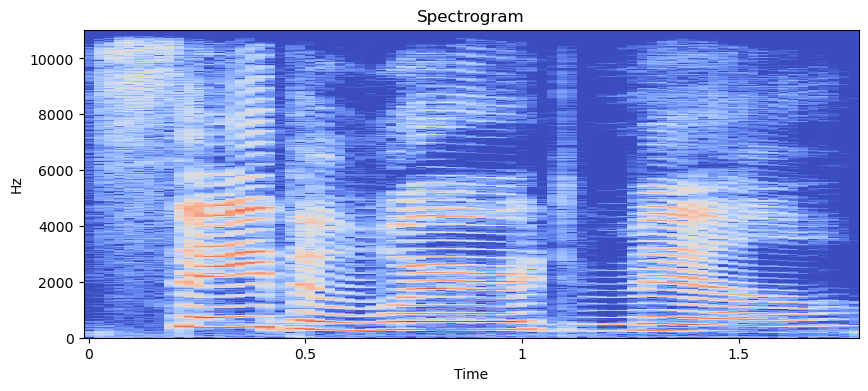

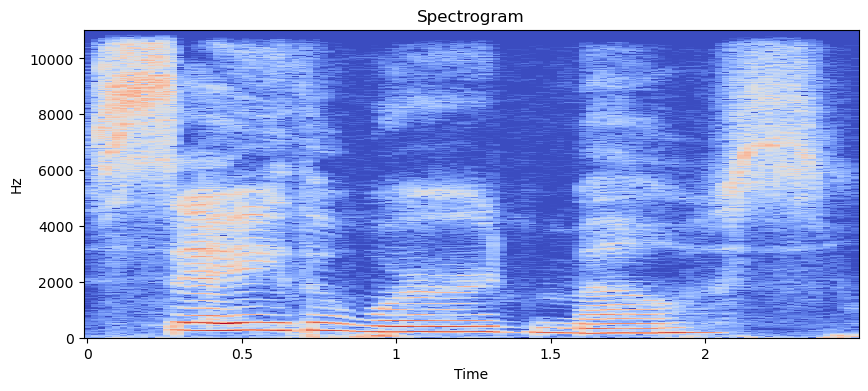

AttributeError: module 'matplotlib' has no attribute 'pyplot'

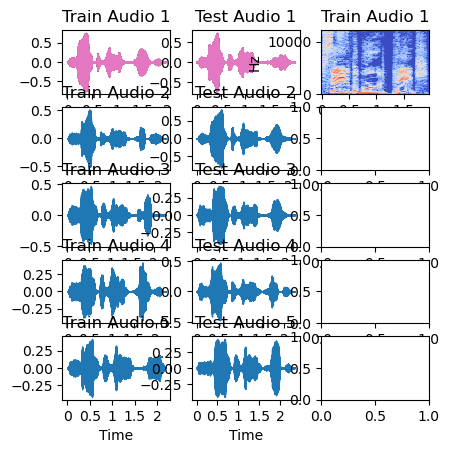

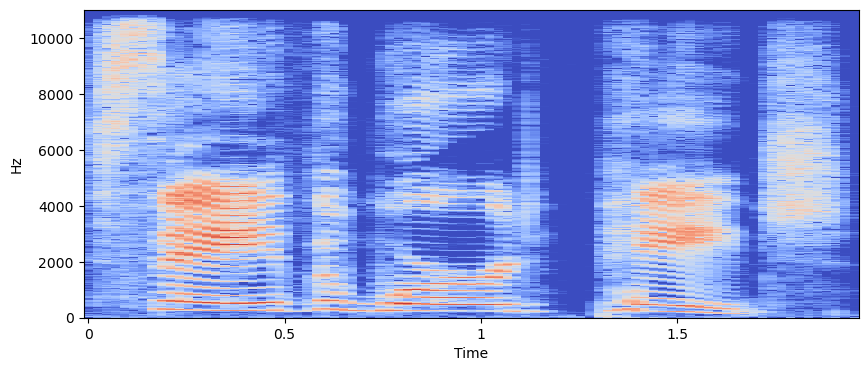

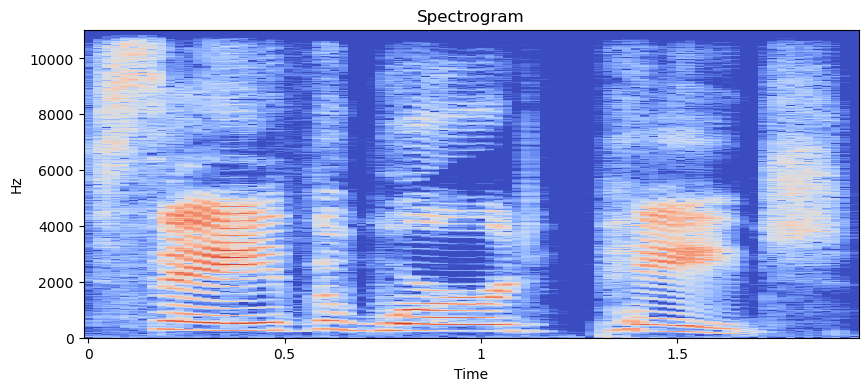

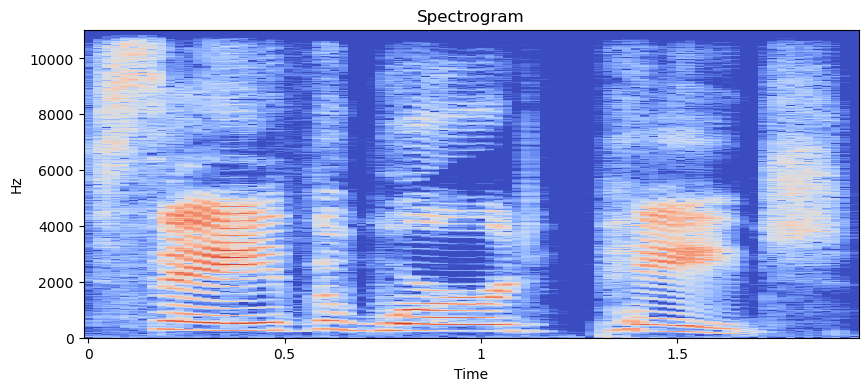

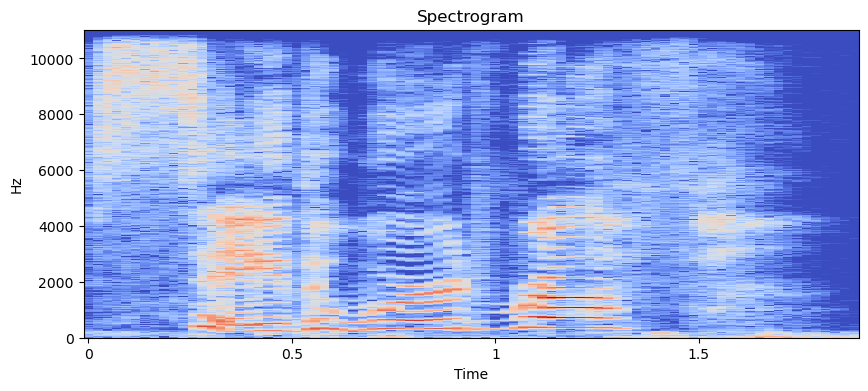

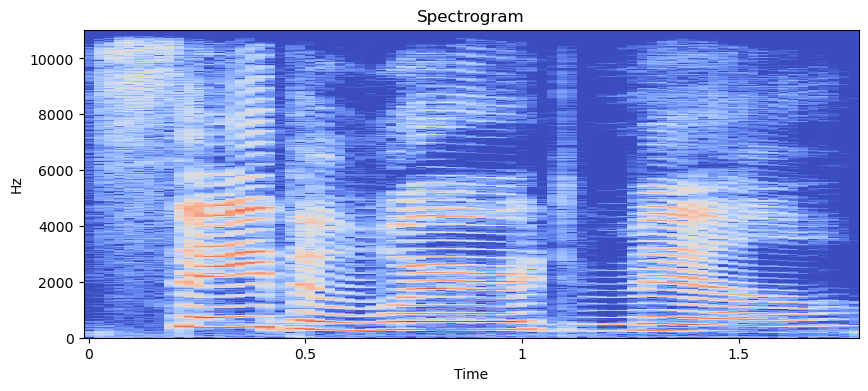

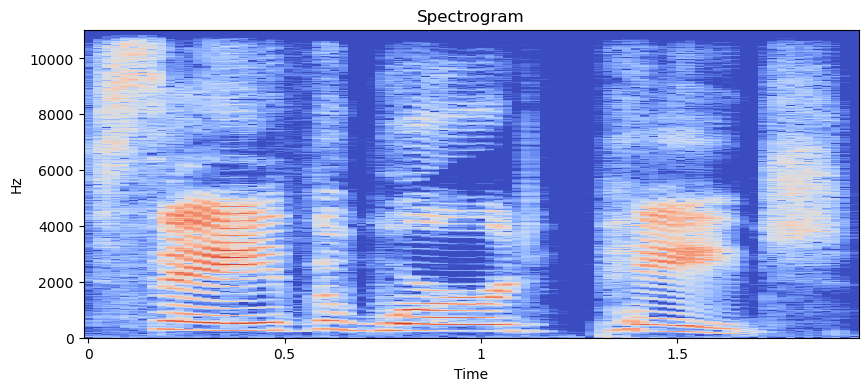

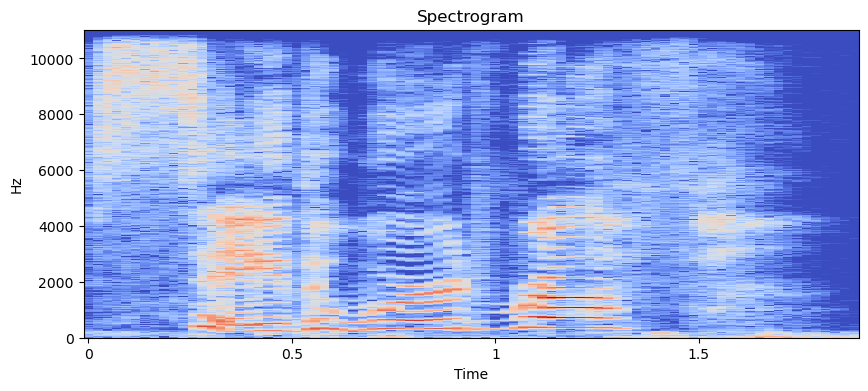

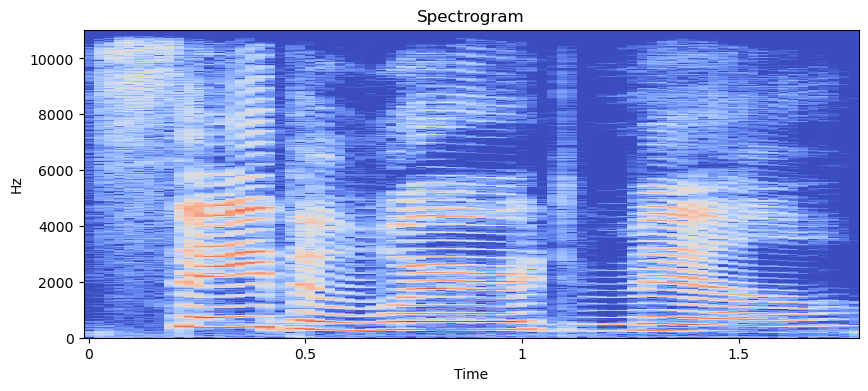

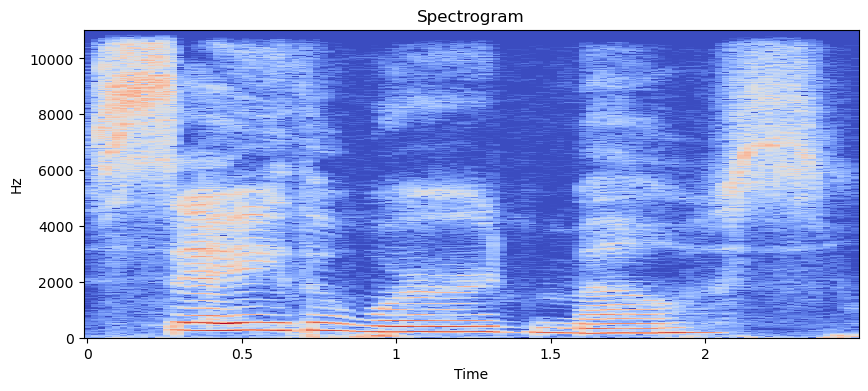

AttributeError: module 'matplotlib' has no attribute 'pyplot'

In [80]:
plotData(sadTrainSample, sadTrainDir)

In [83]:
def plotAmplitude(audio_dataset, path):   
    for audio in audio_dataset:
        file_path = os.path.join(path, audio)
        
        # load the audio file
        audio_data, audio_sr = librosa.load(file_path)

        # plot the waveform
        plt.figure(figsize=(10, 4))
        librosa.display.waveshow(audio_data, sr=audio_sr)
        plt.title('Waveform')
        plt.xlabel('Time (s)')
        plt.ylabel('Amplitude')
        plt.show()

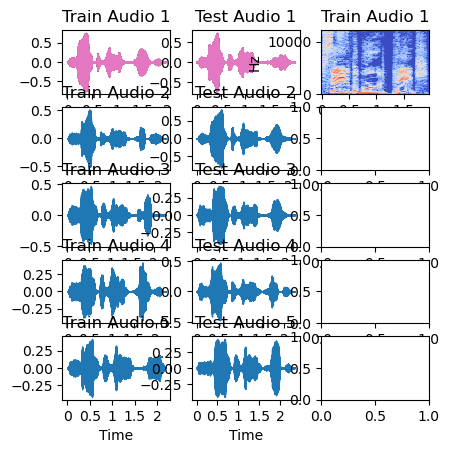

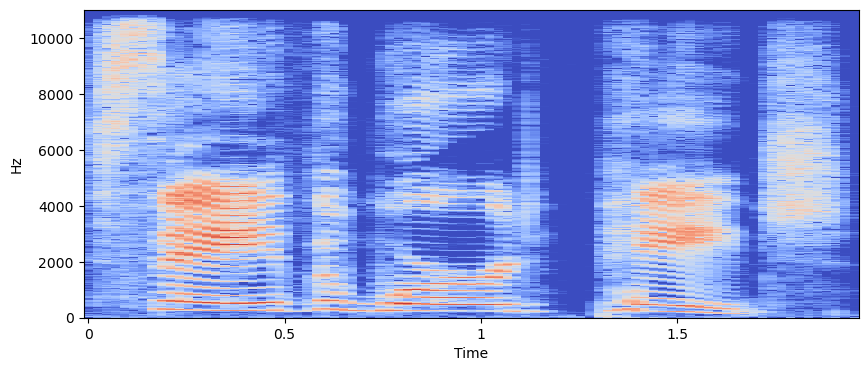

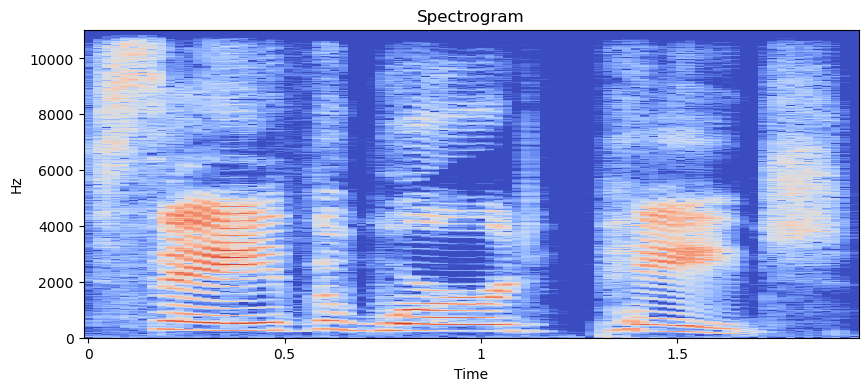

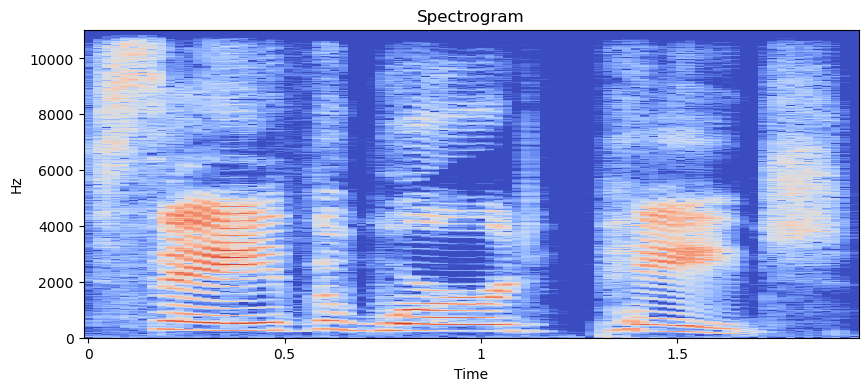

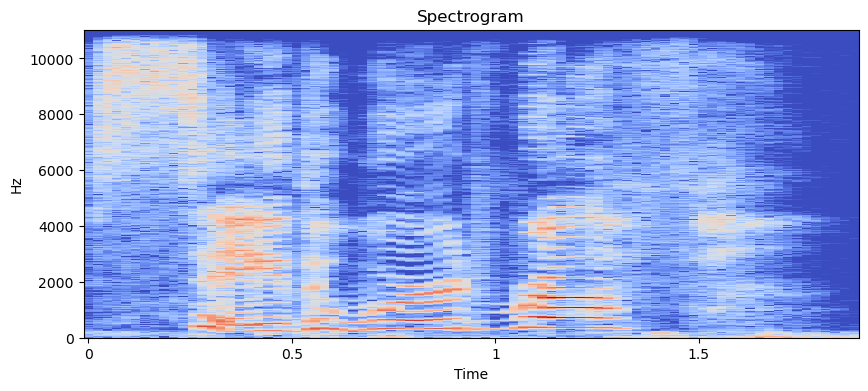

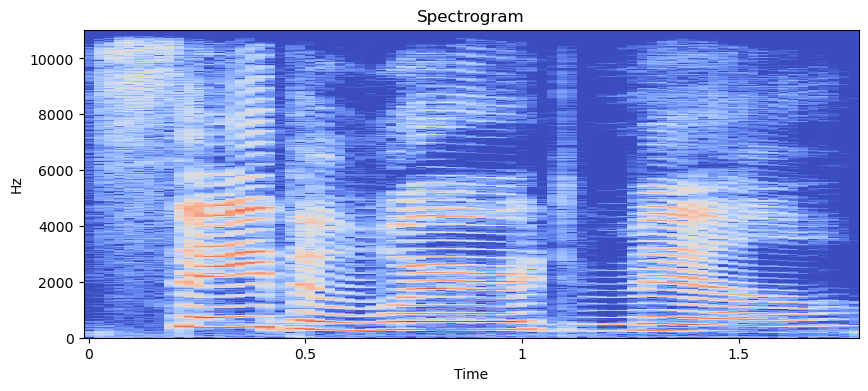

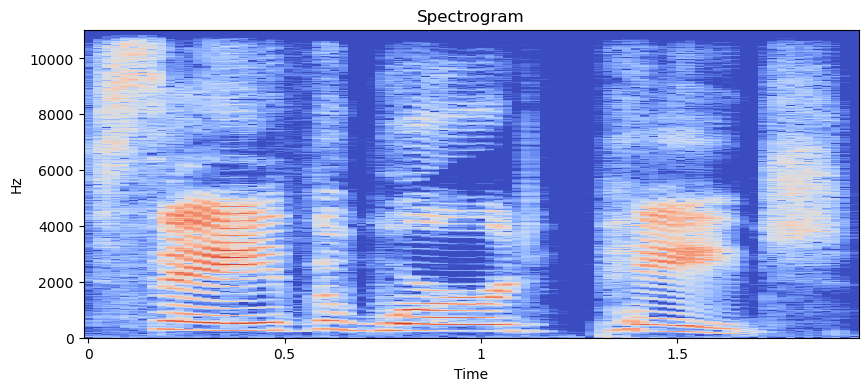

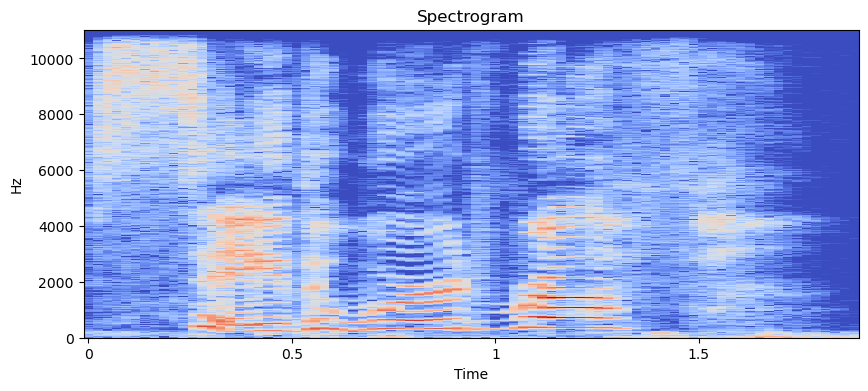

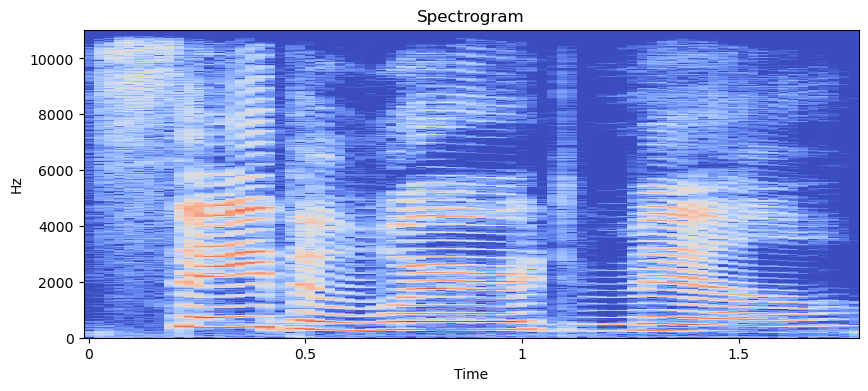

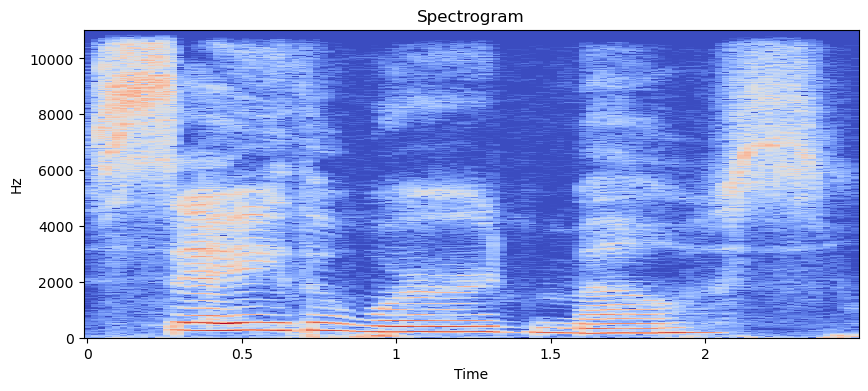

<Figure size 1000x400 with 0 Axes>

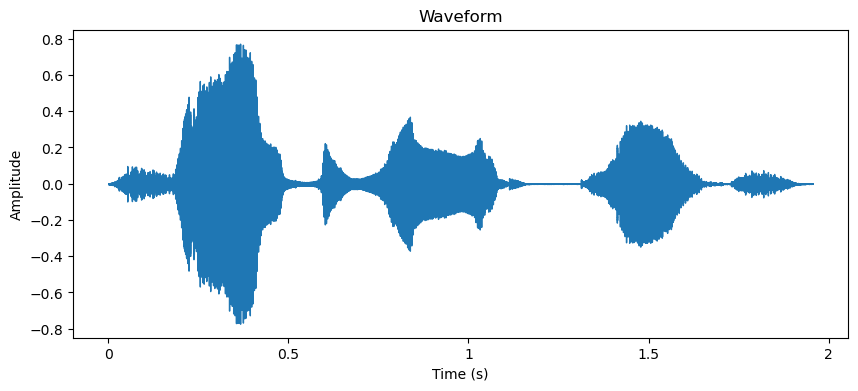

AttributeError: module 'matplotlib' has no attribute 'pyplot'

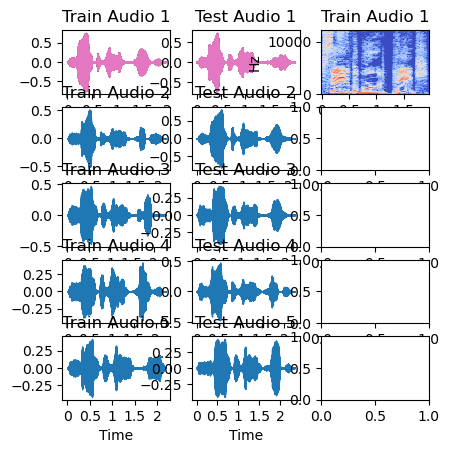

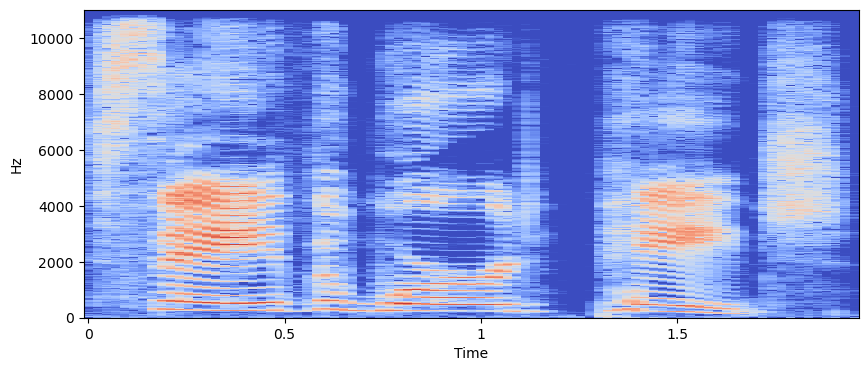

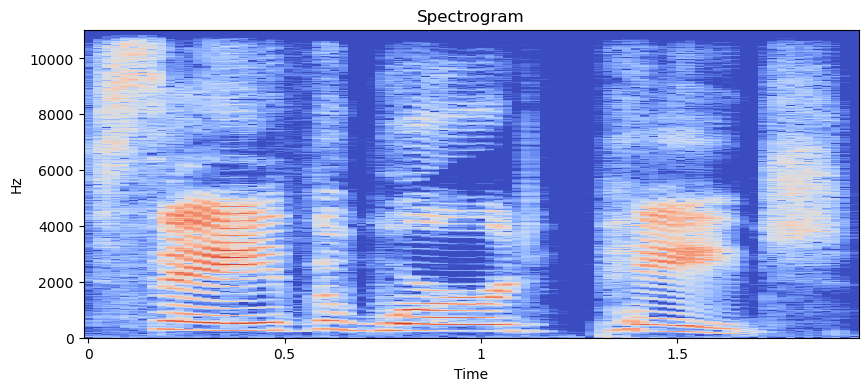

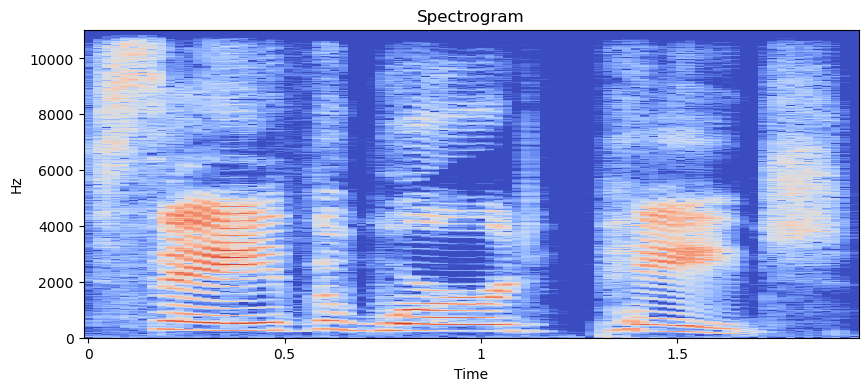

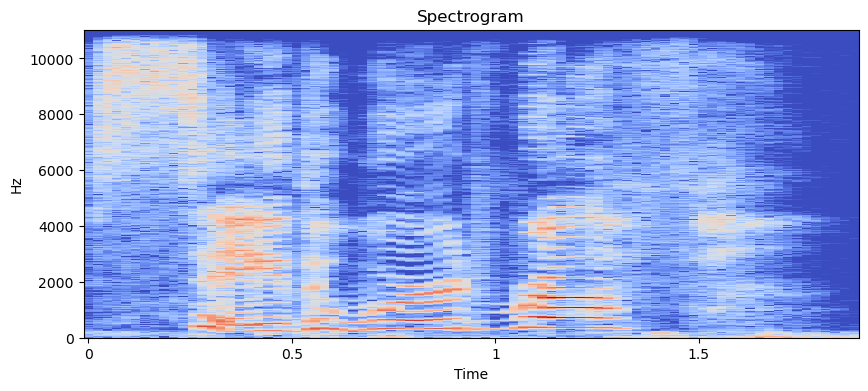

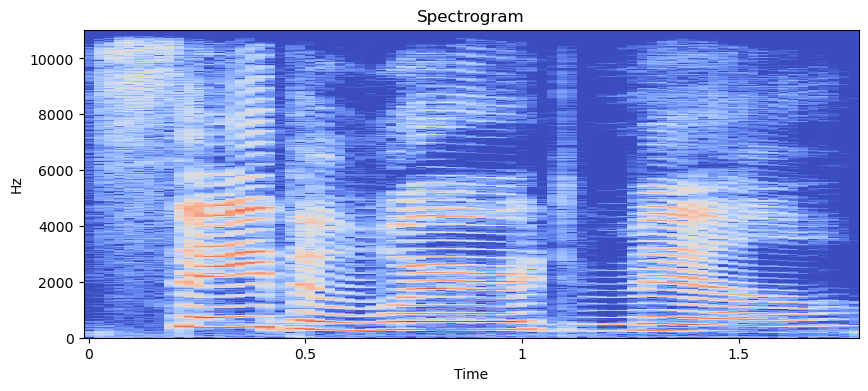

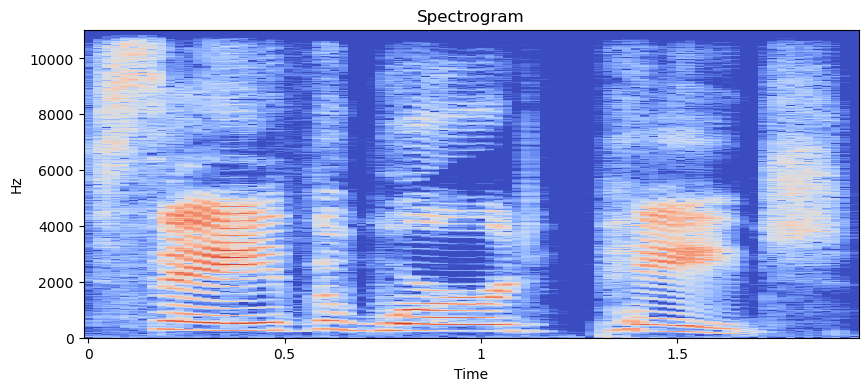

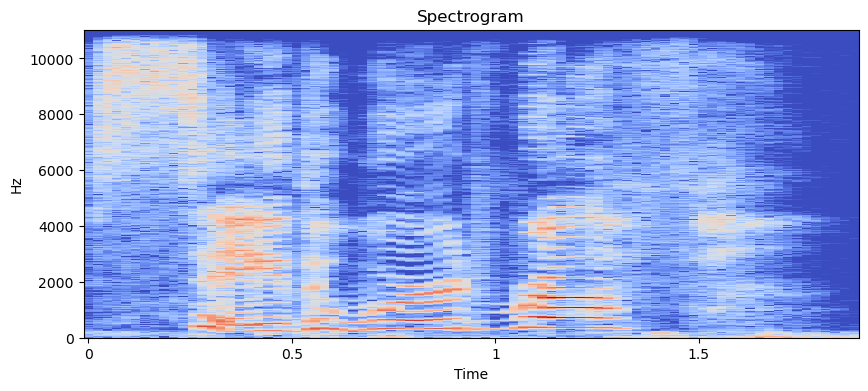

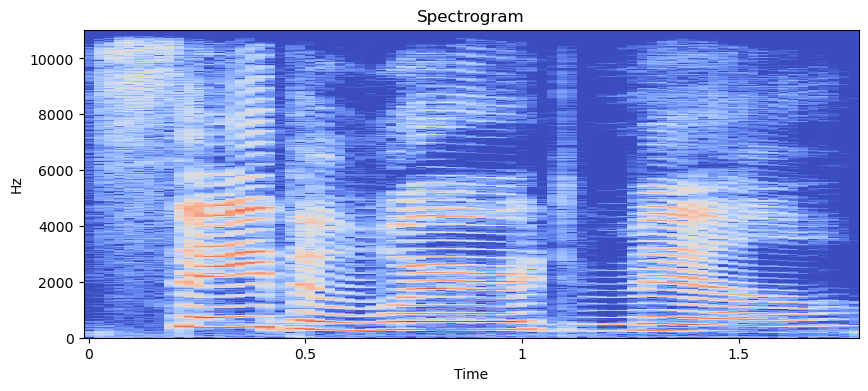

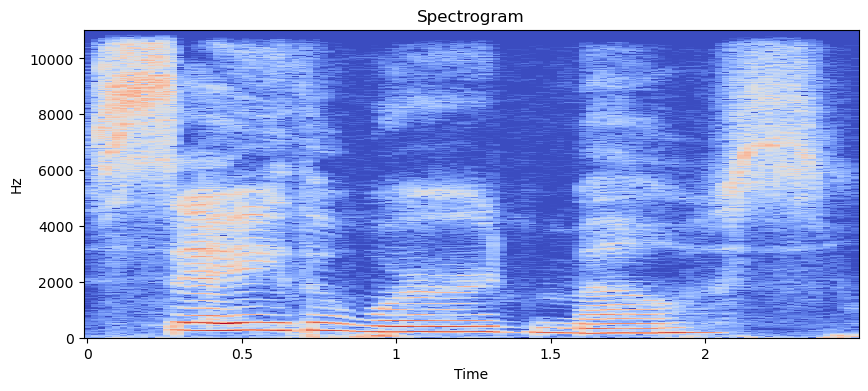

<Figure size 1000x400 with 0 Axes>

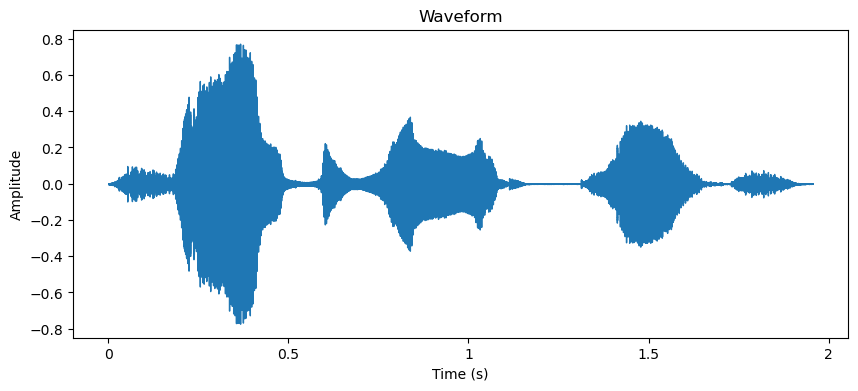

AttributeError: module 'matplotlib' has no attribute 'pyplot'

In [84]:
plotAmplitude(angryTrainSample, angryTrainDir)

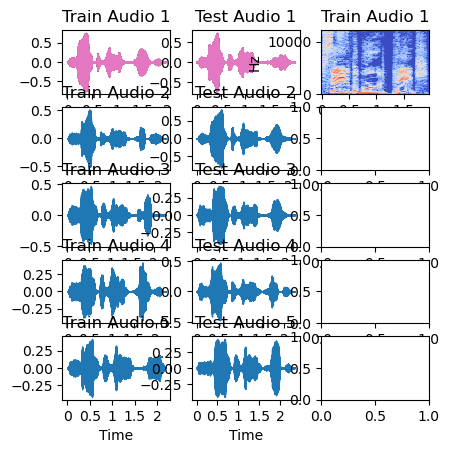

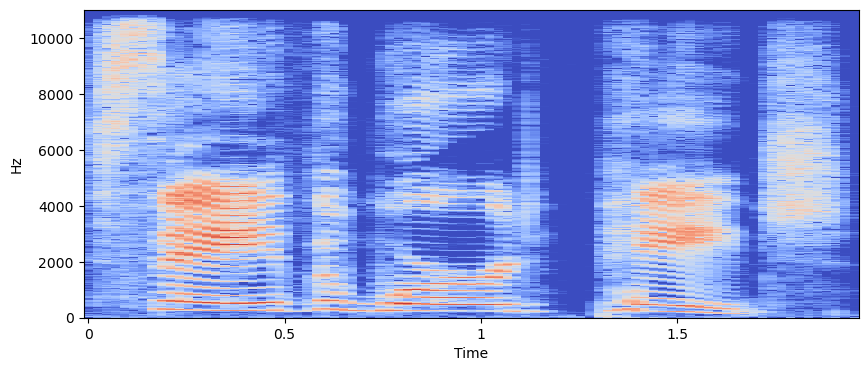

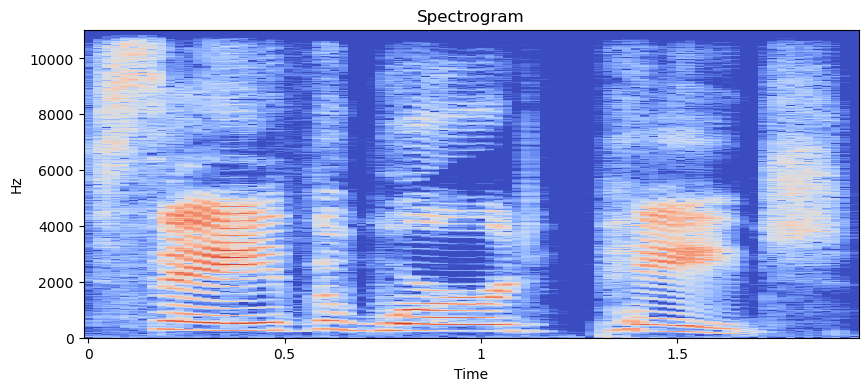

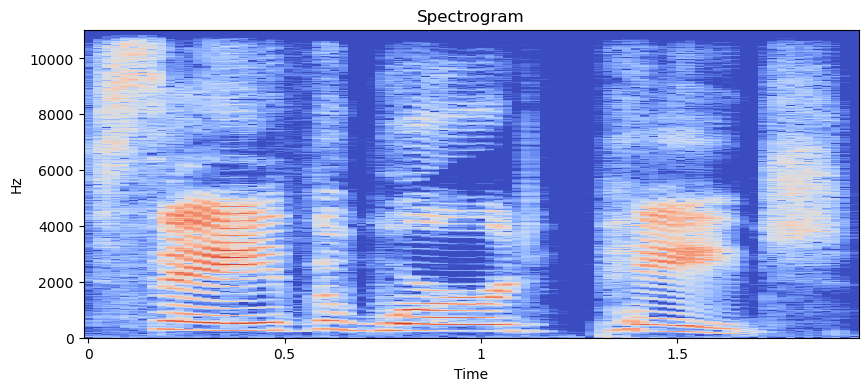

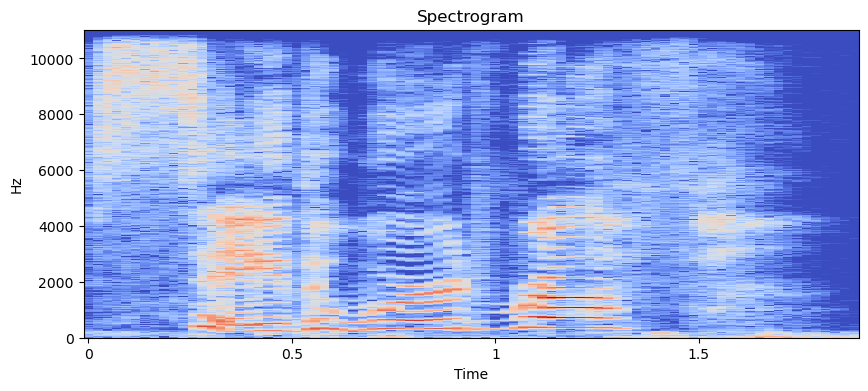

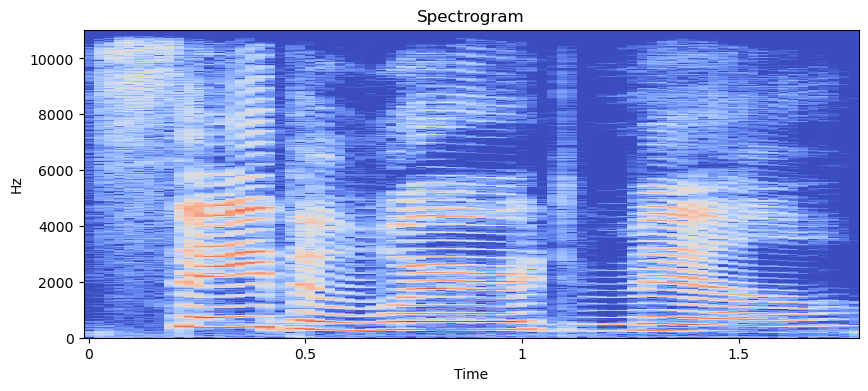

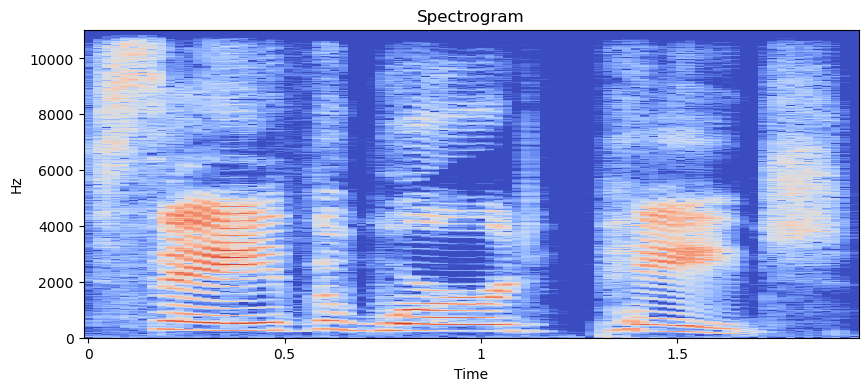

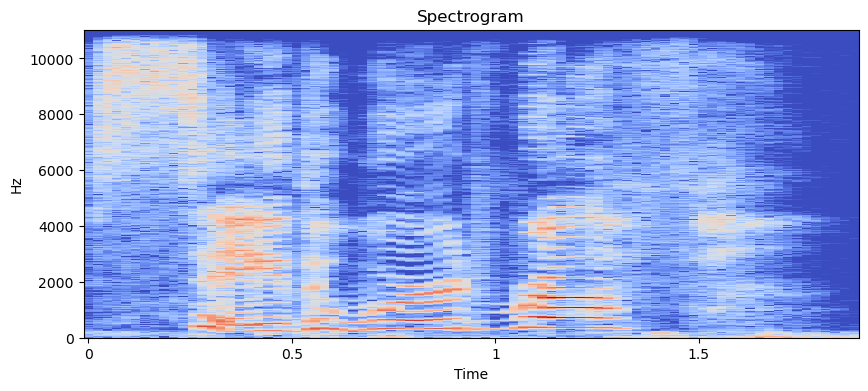

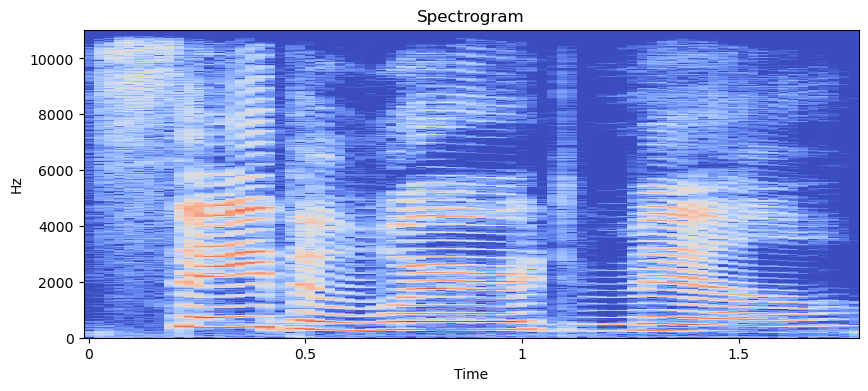

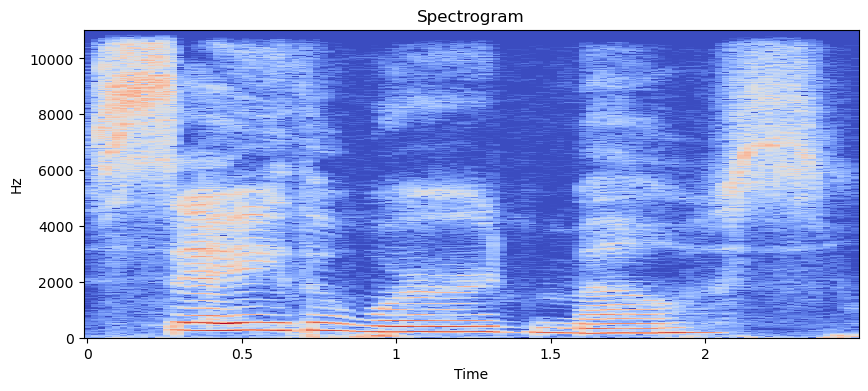

<Figure size 1000x400 with 0 Axes>

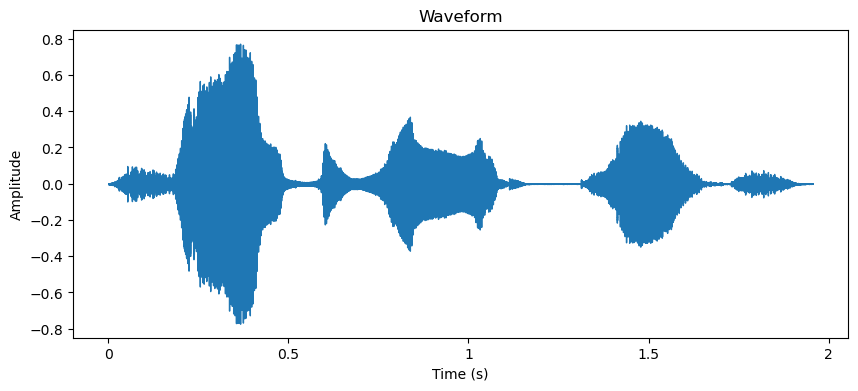

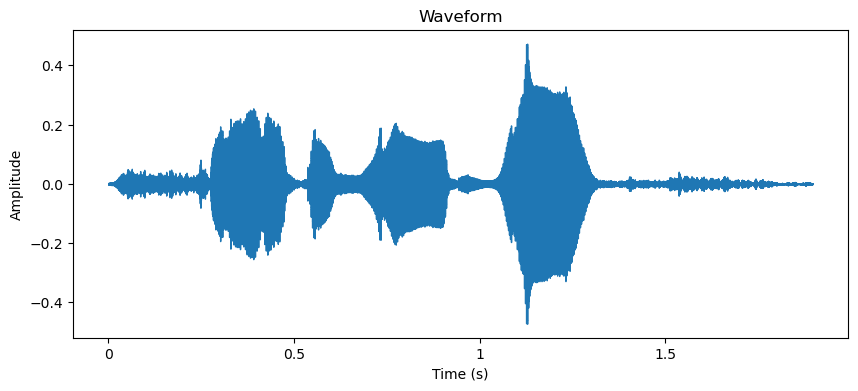

AttributeError: module 'matplotlib' has no attribute 'pyplot'

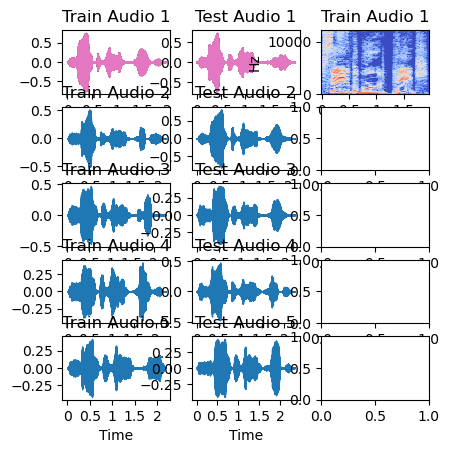

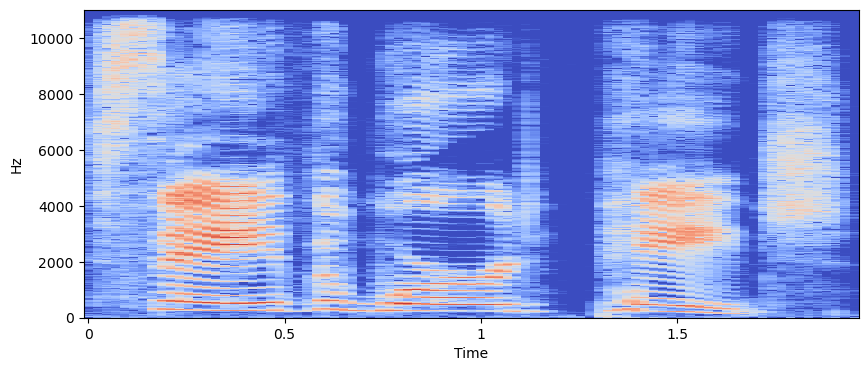

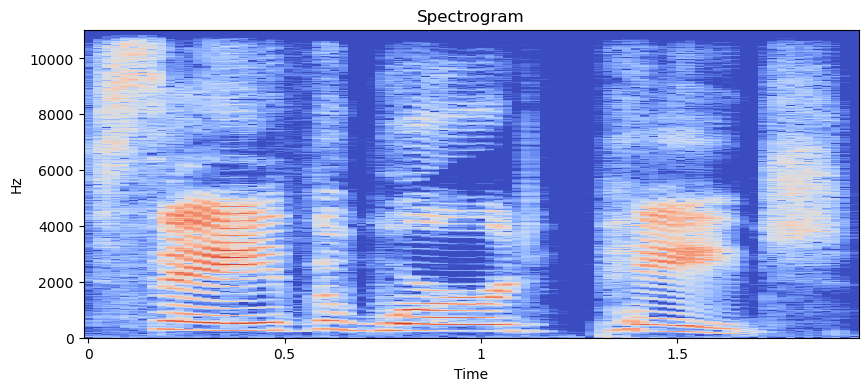

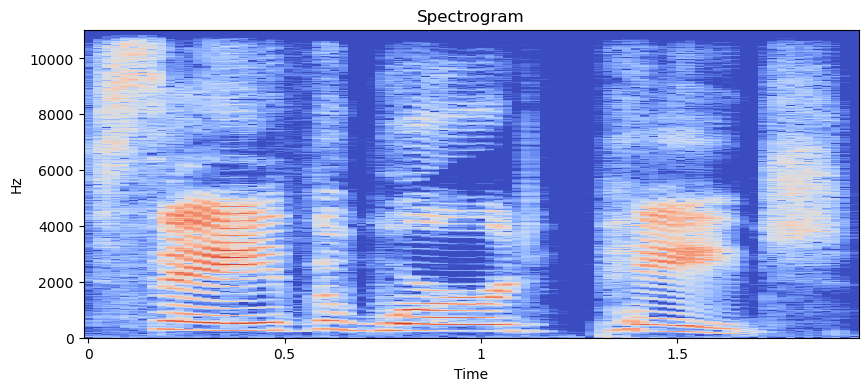

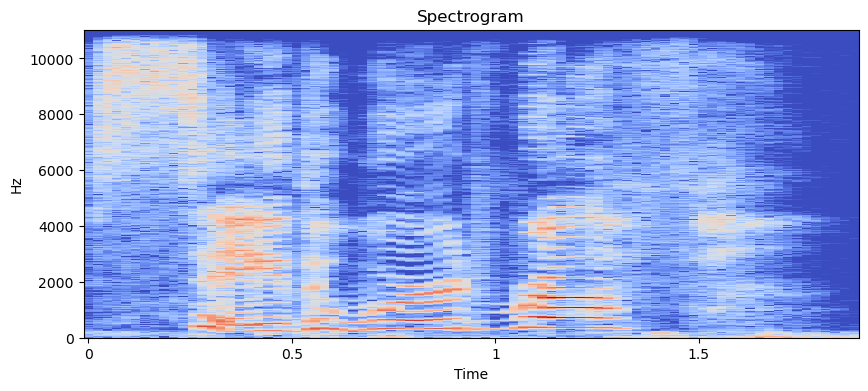

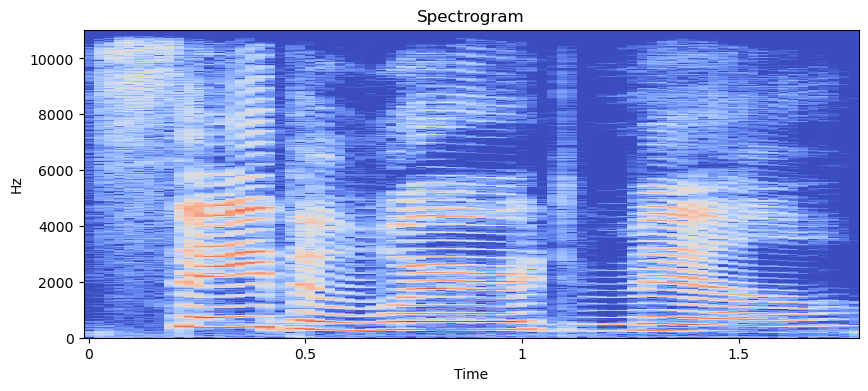

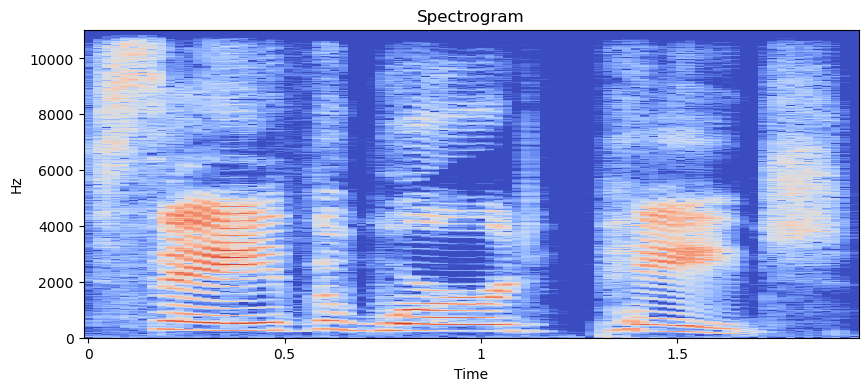

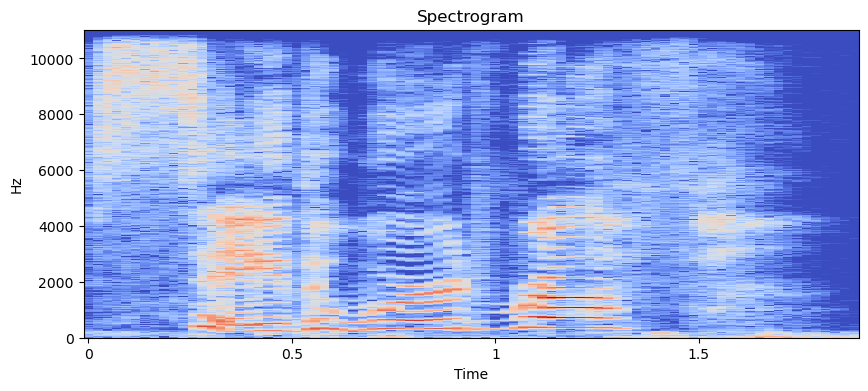

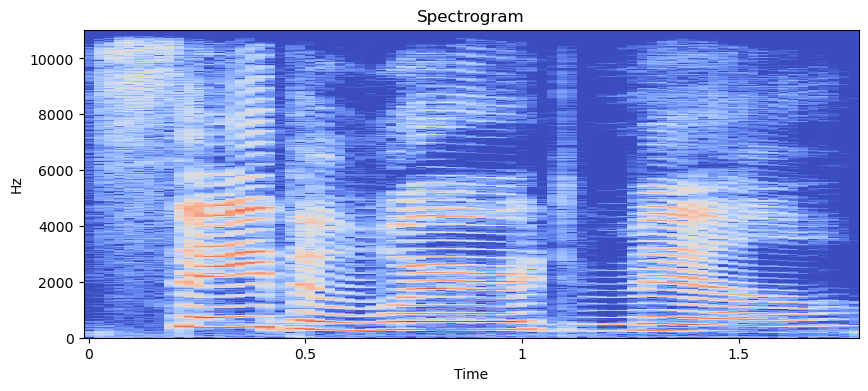

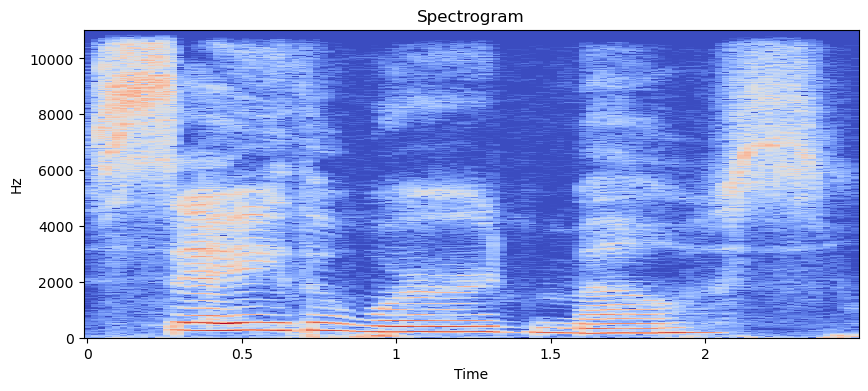

<Figure size 1000x400 with 0 Axes>

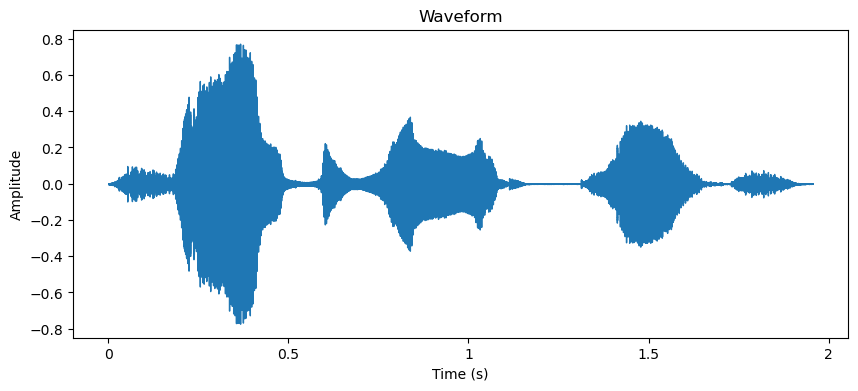

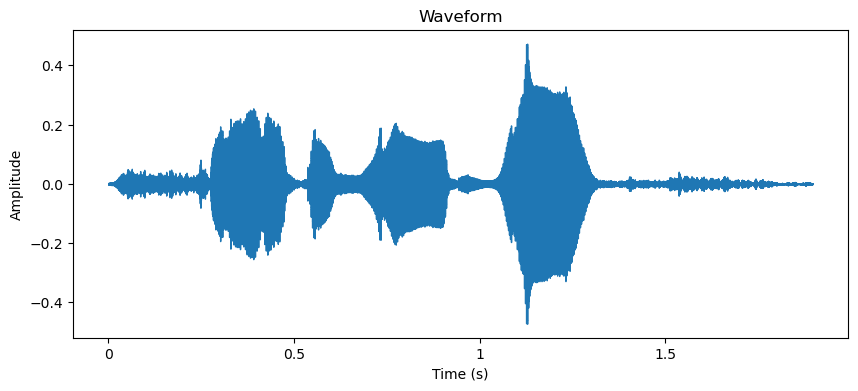

AttributeError: module 'matplotlib' has no attribute 'pyplot'

In [85]:
plotAmplitude(fearTrainSample, fearTrainDir)

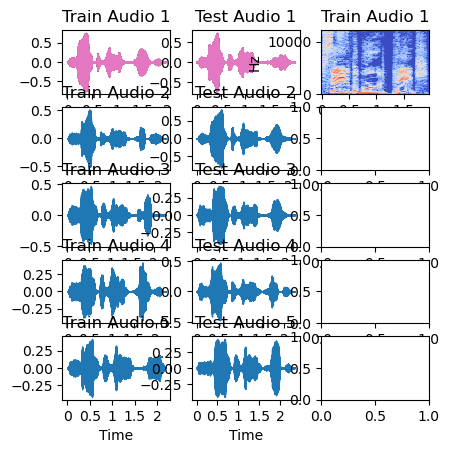

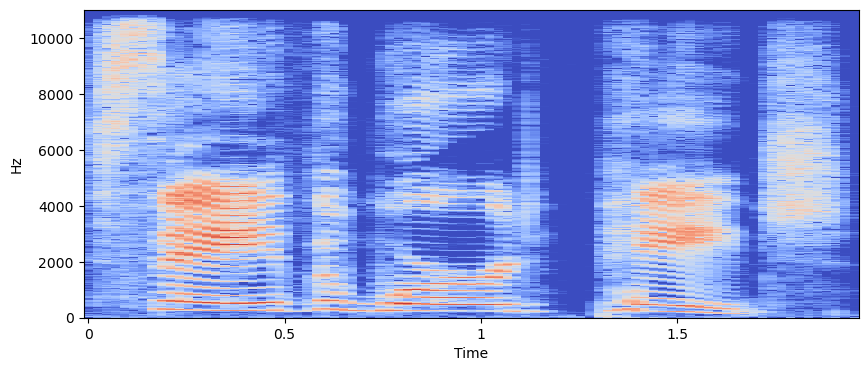

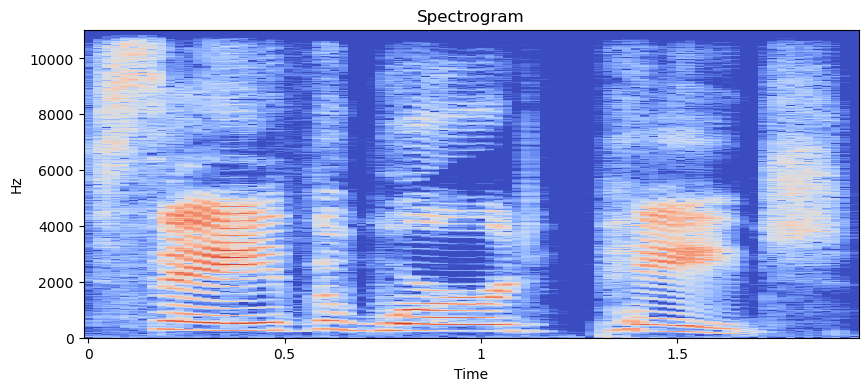

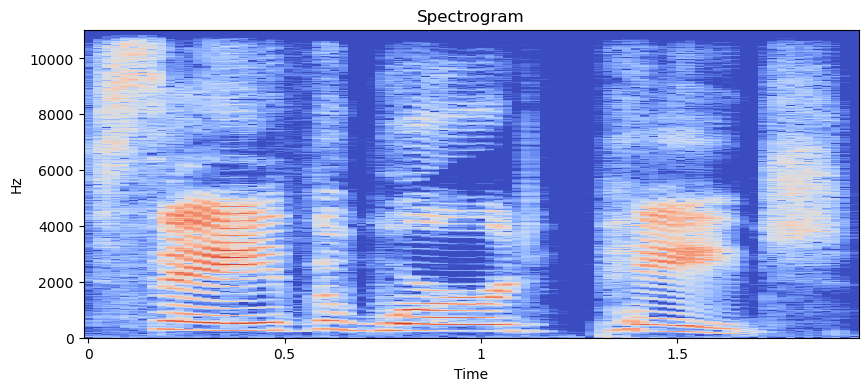

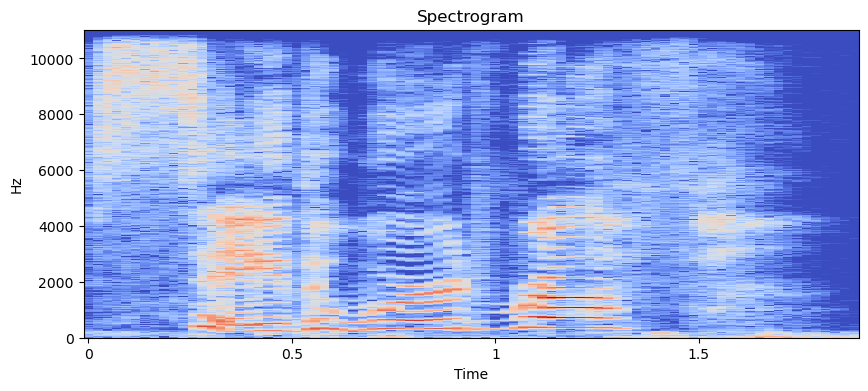

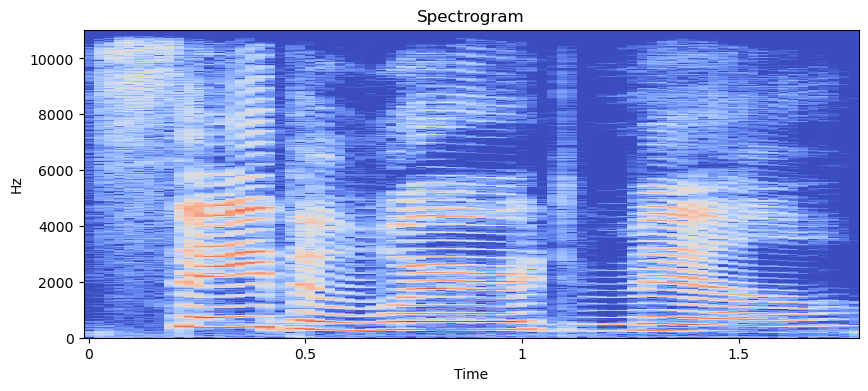

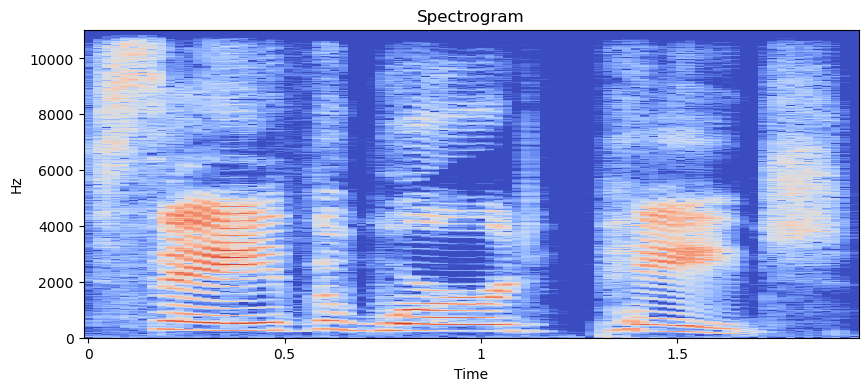

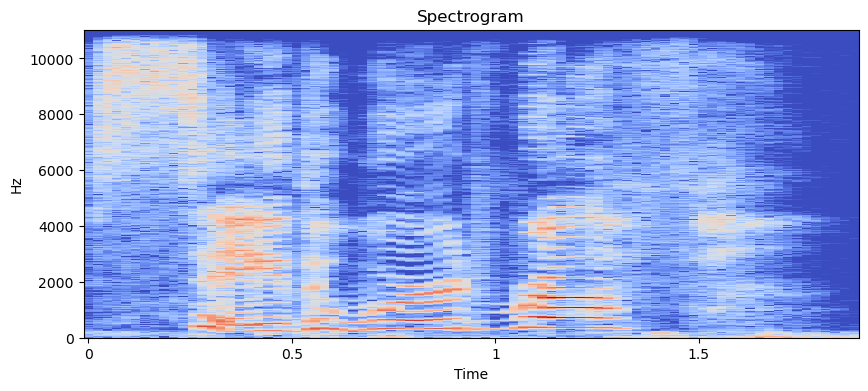

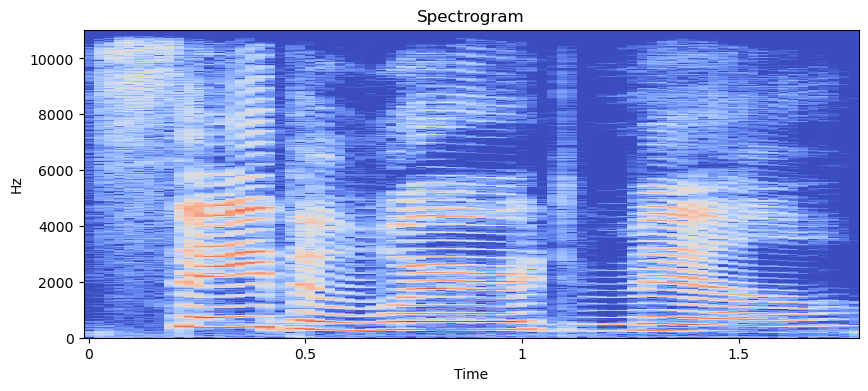

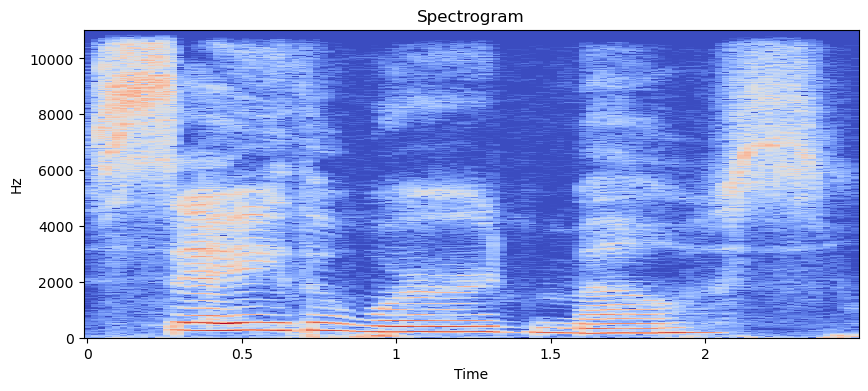

<Figure size 1000x400 with 0 Axes>

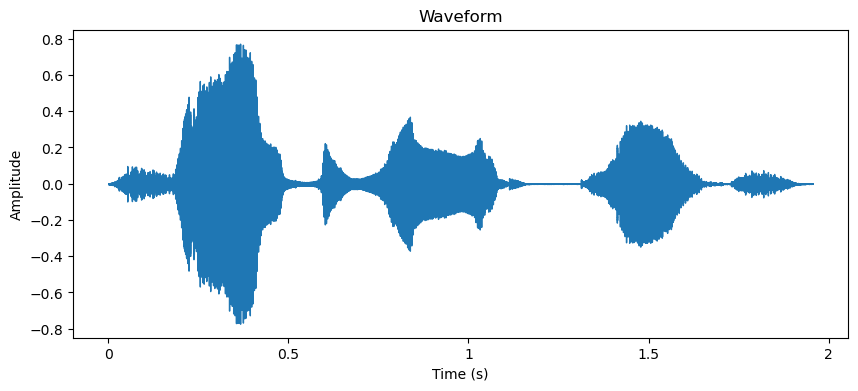

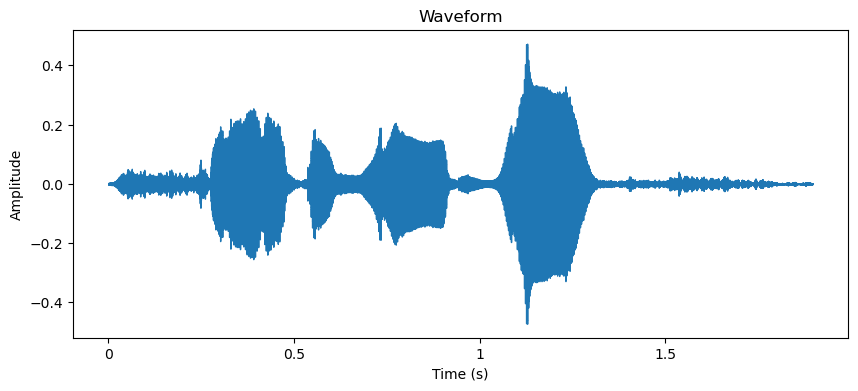

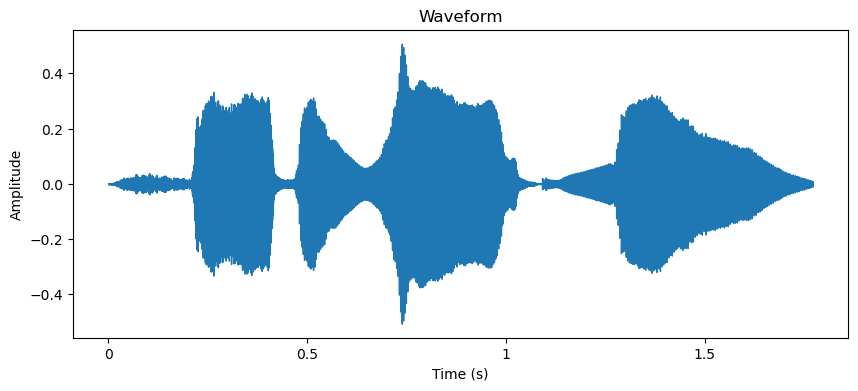

AttributeError: module 'matplotlib' has no attribute 'pyplot'

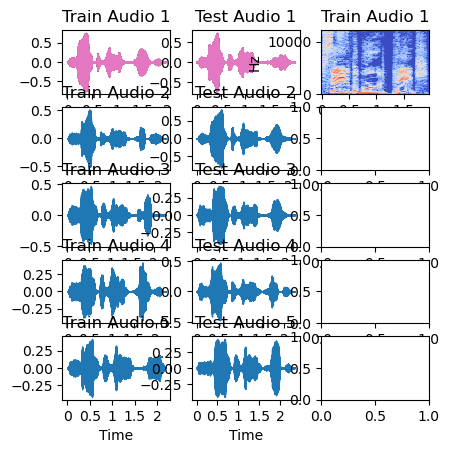

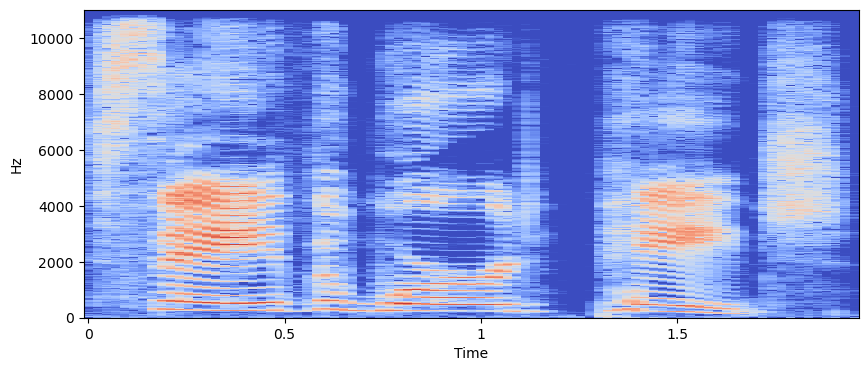

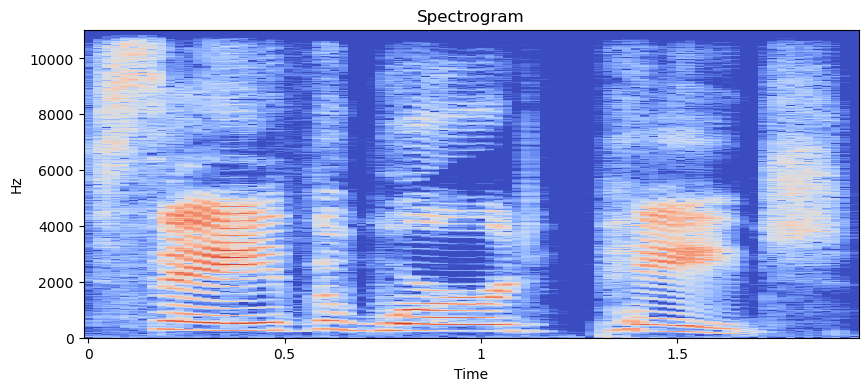

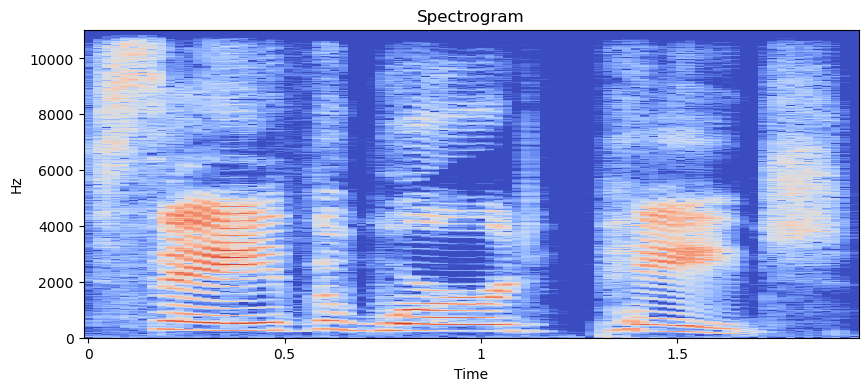

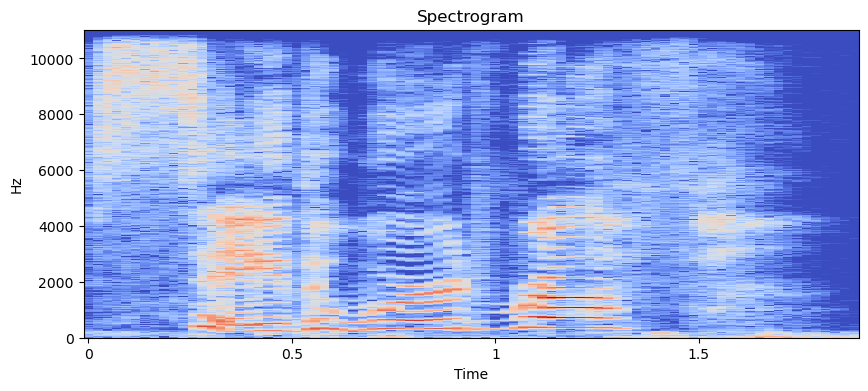

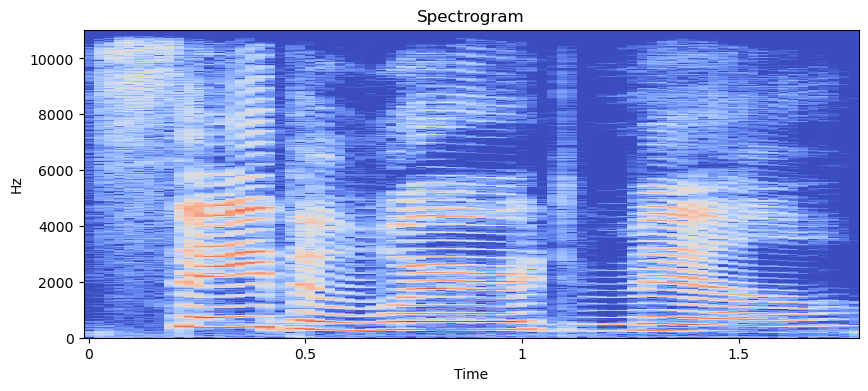

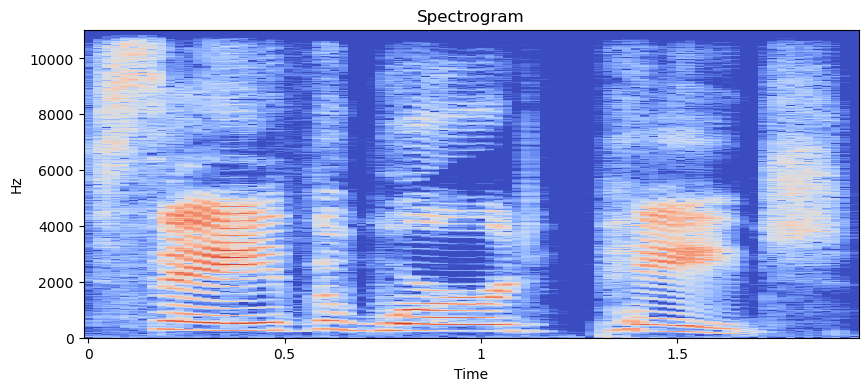

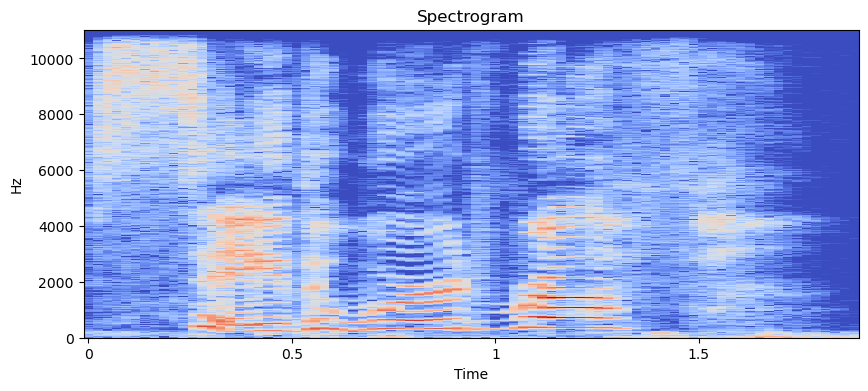

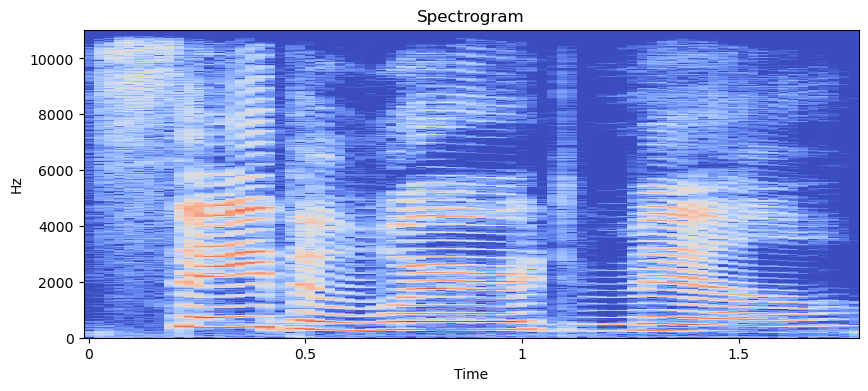

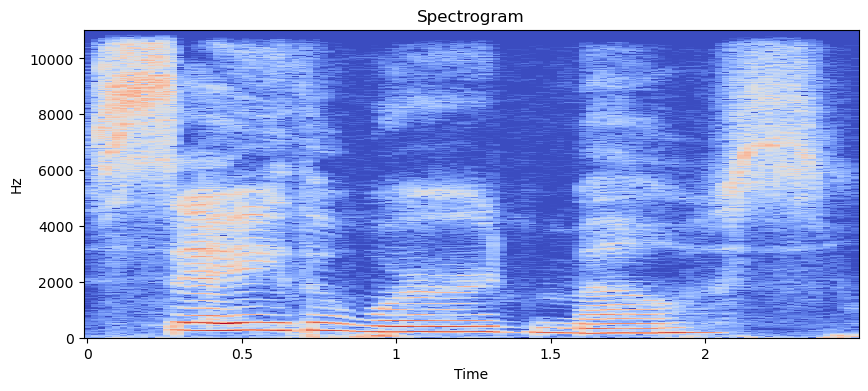

<Figure size 1000x400 with 0 Axes>

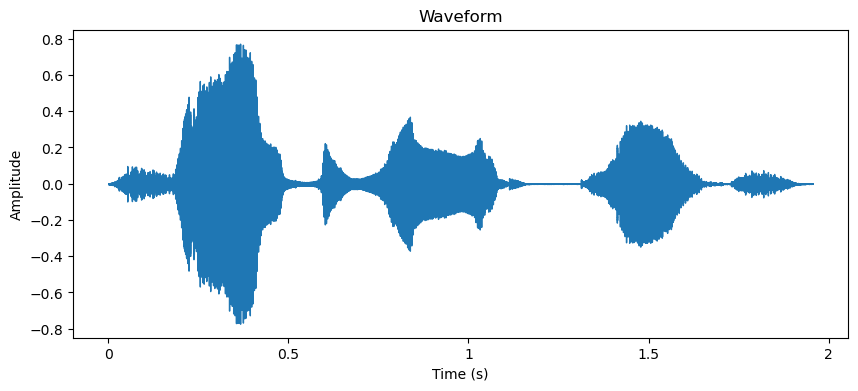

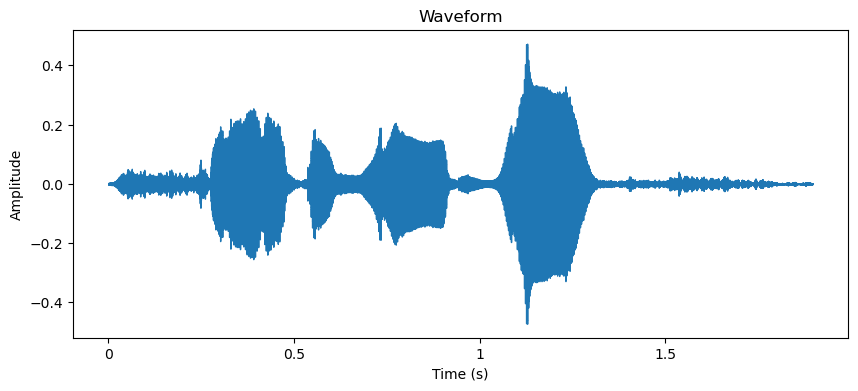

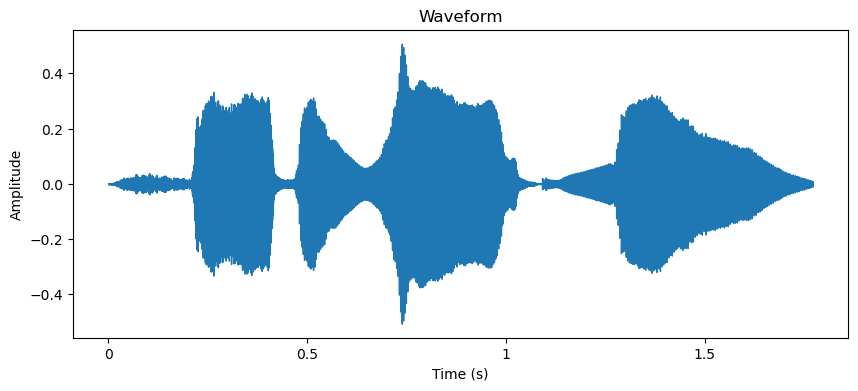

AttributeError: module 'matplotlib' has no attribute 'pyplot'

In [87]:
plotAmplitude(happyTrainSample, happyTrainDir)

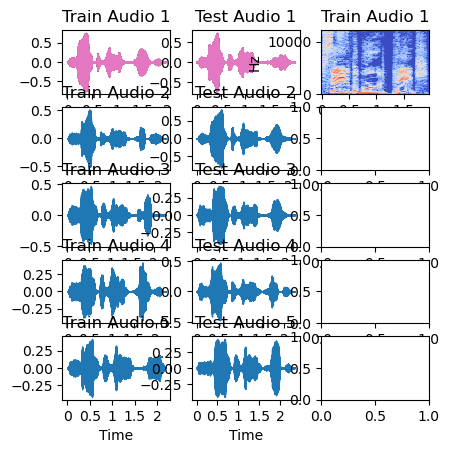

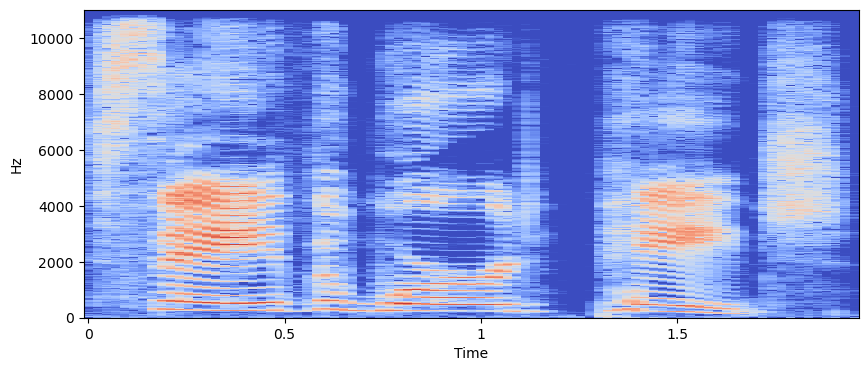

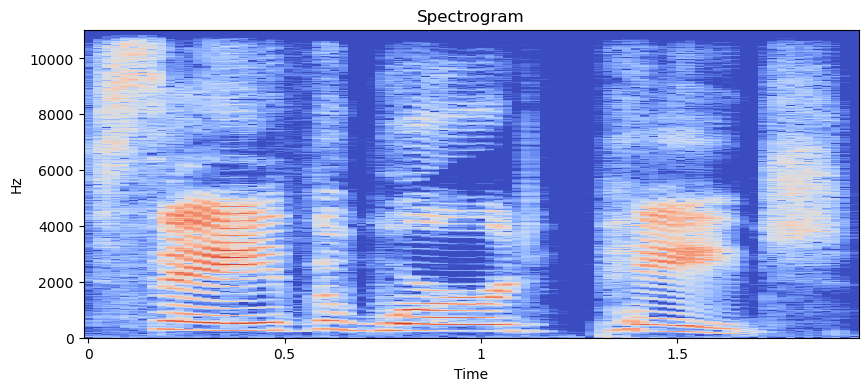

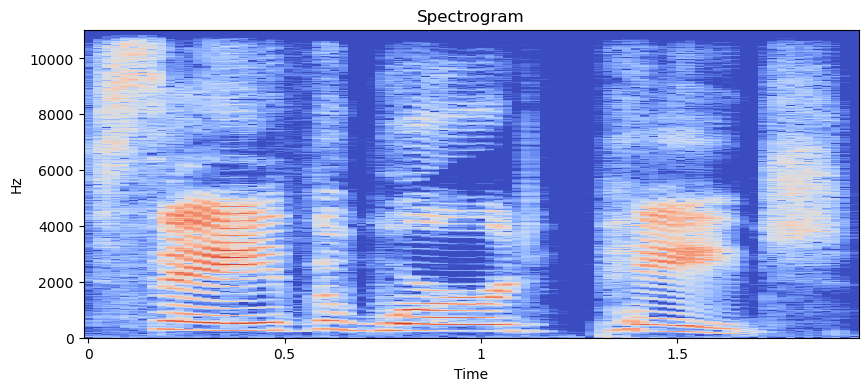

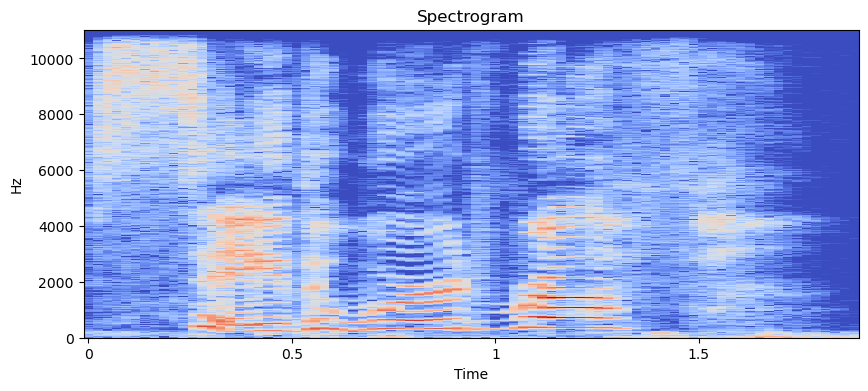

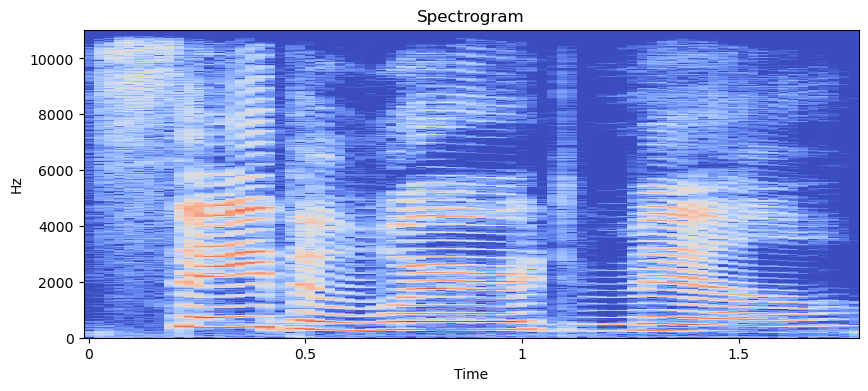

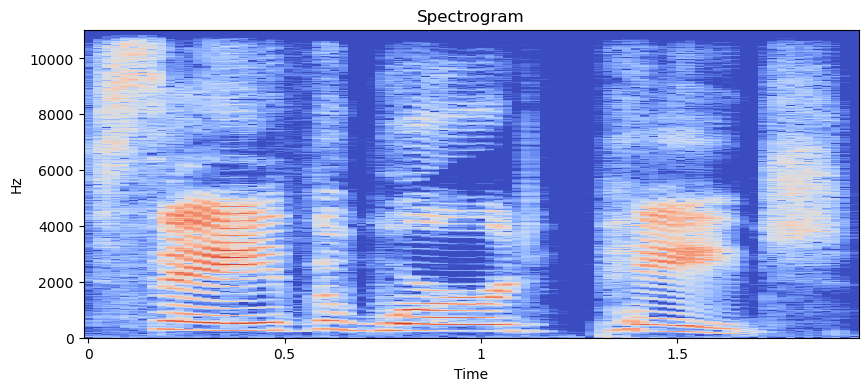

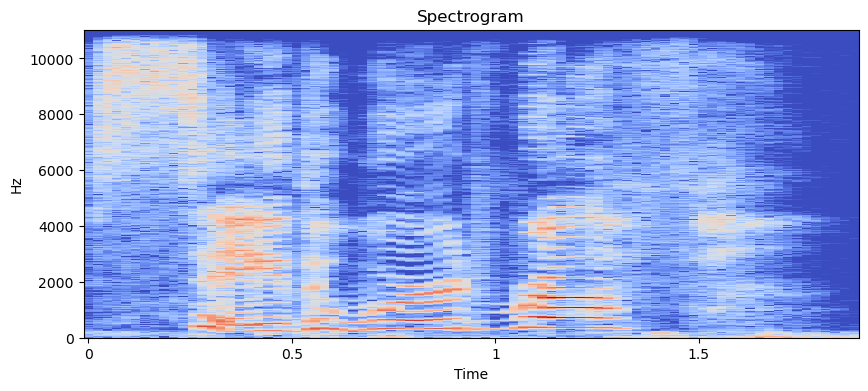

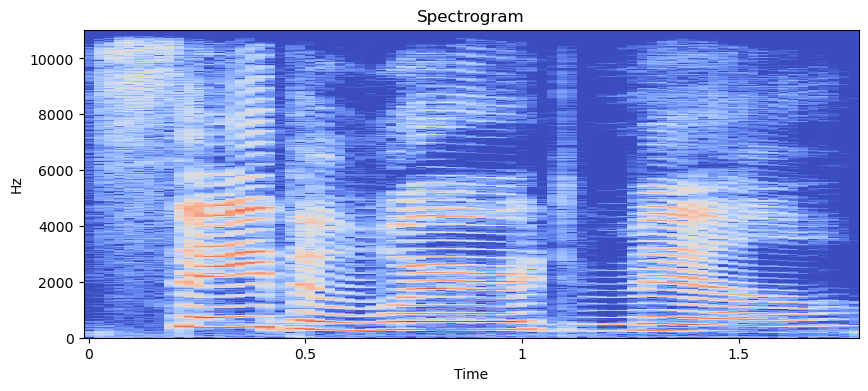

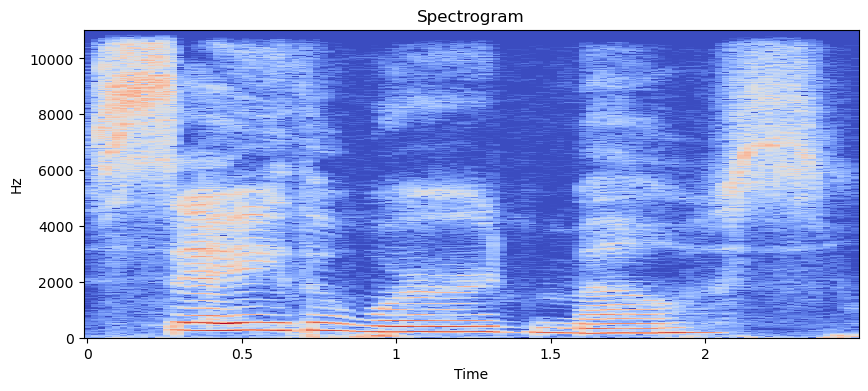

<Figure size 1000x400 with 0 Axes>

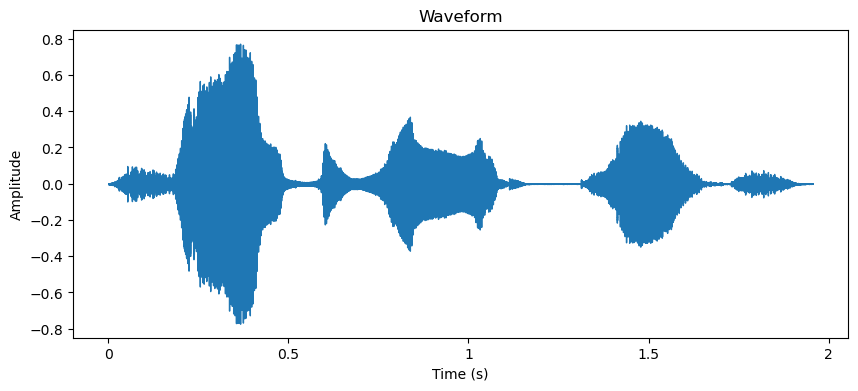

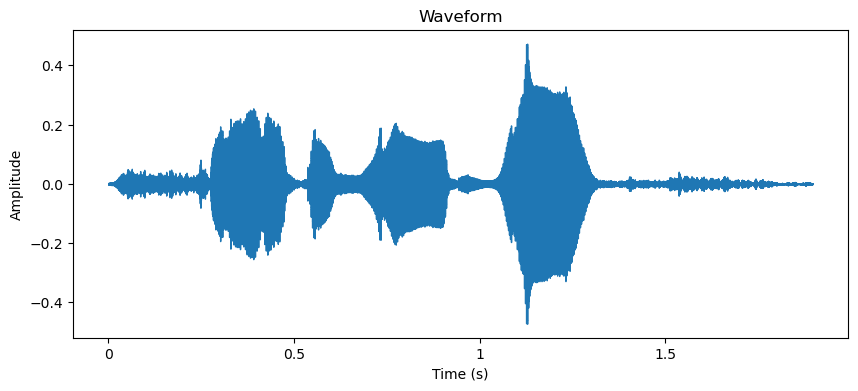

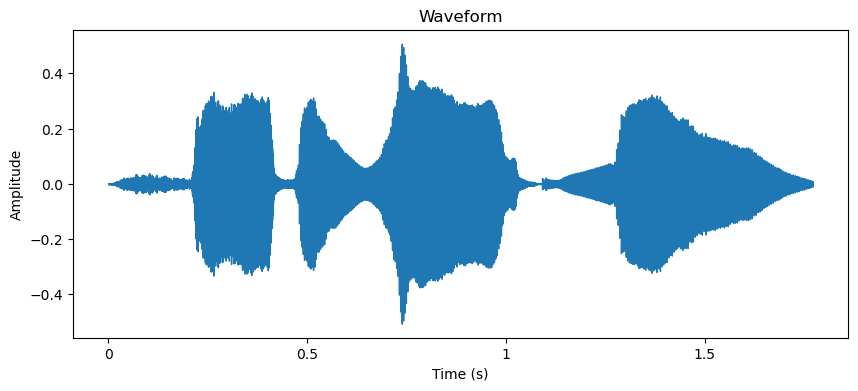

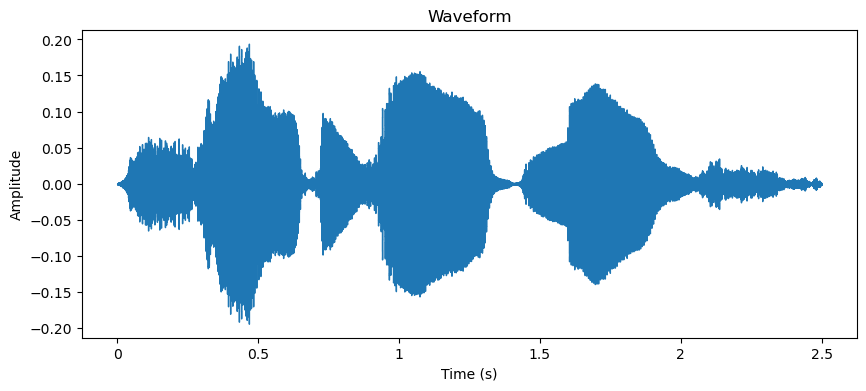

AttributeError: module 'matplotlib' has no attribute 'pyplot'

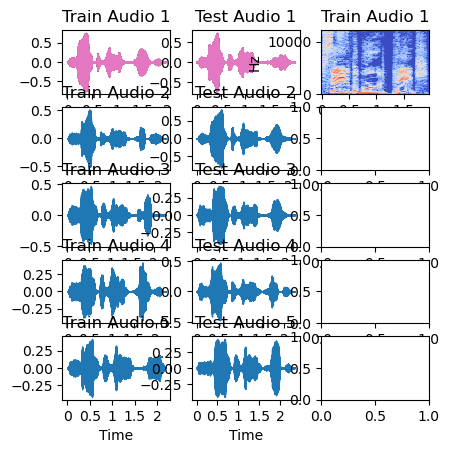

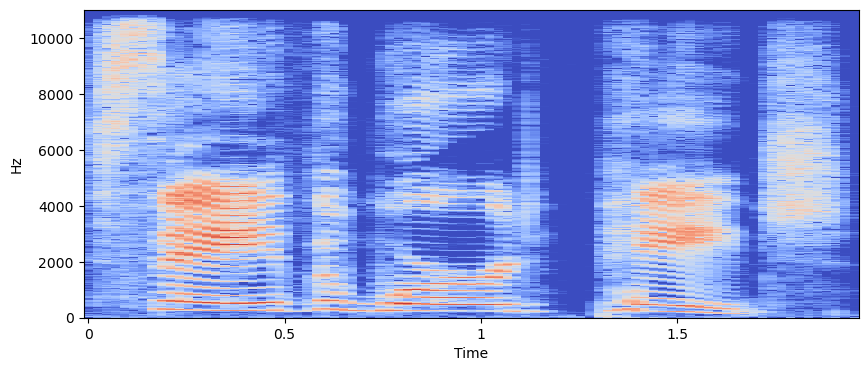

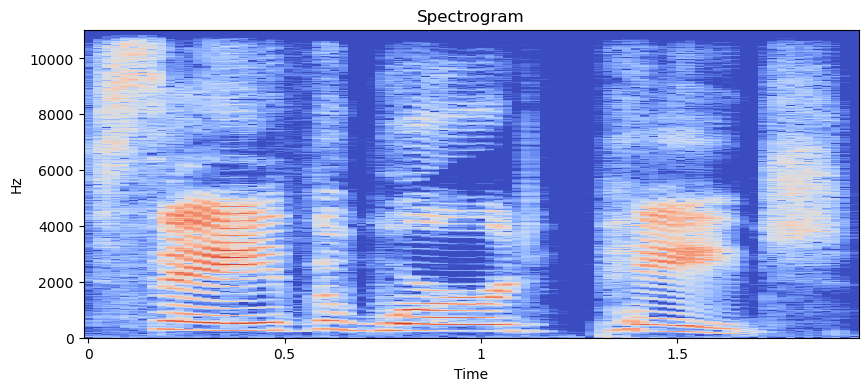

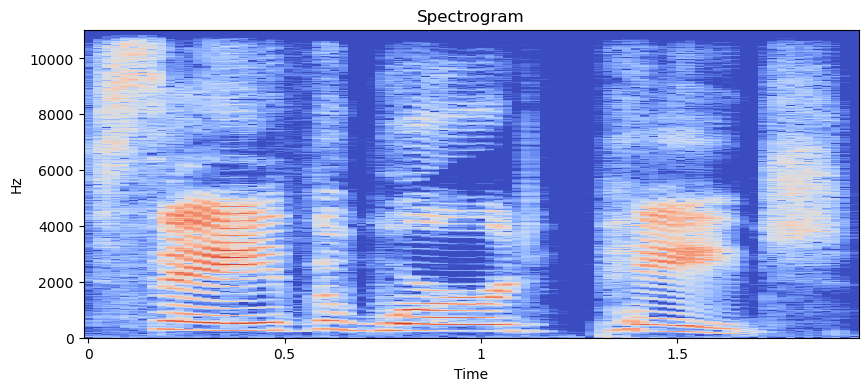

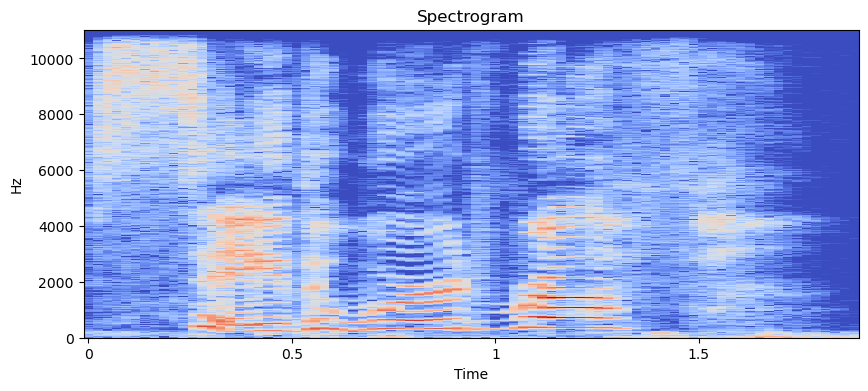

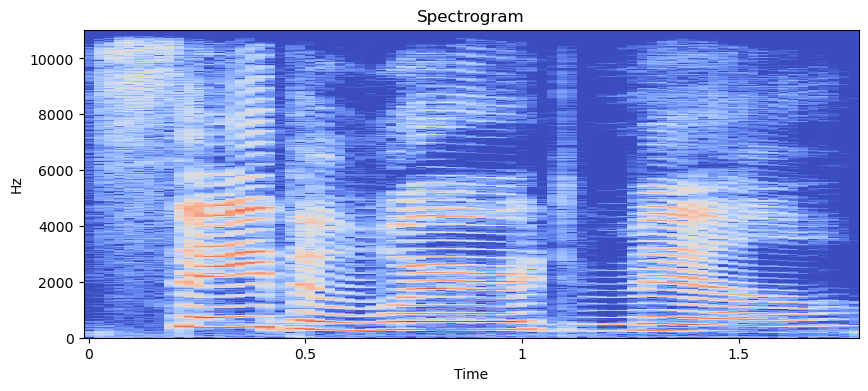

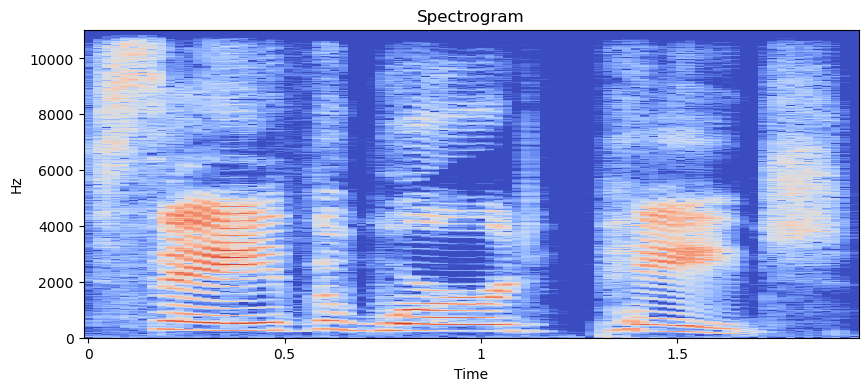

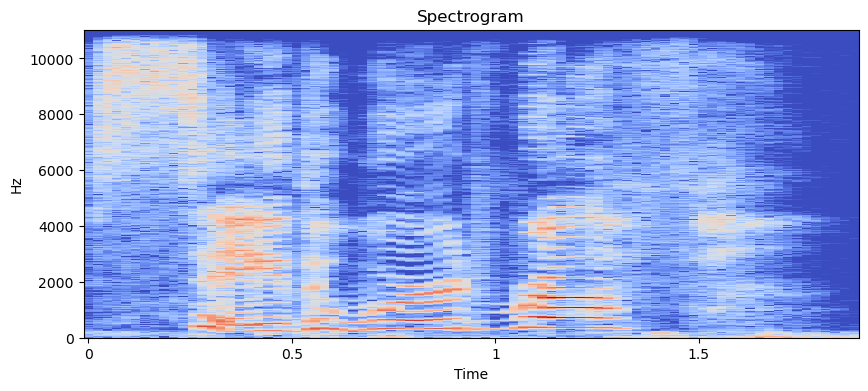

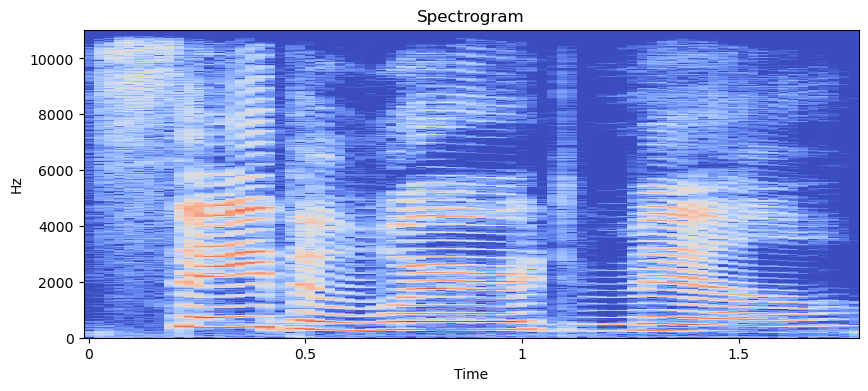

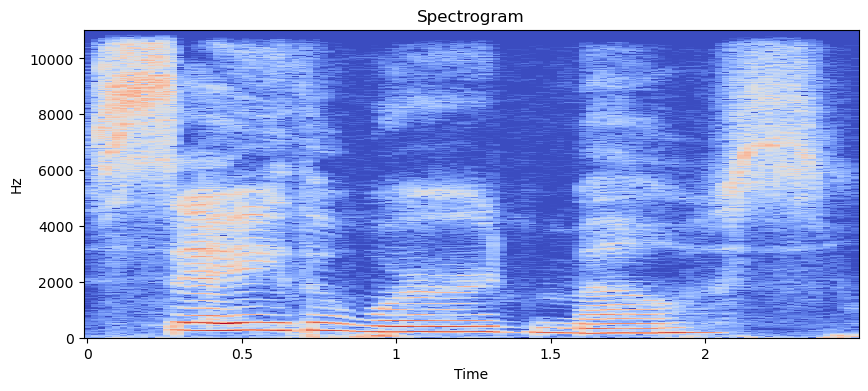

<Figure size 1000x400 with 0 Axes>

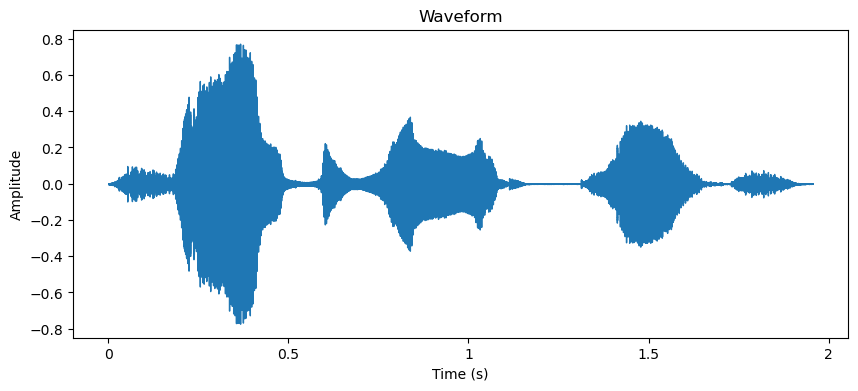

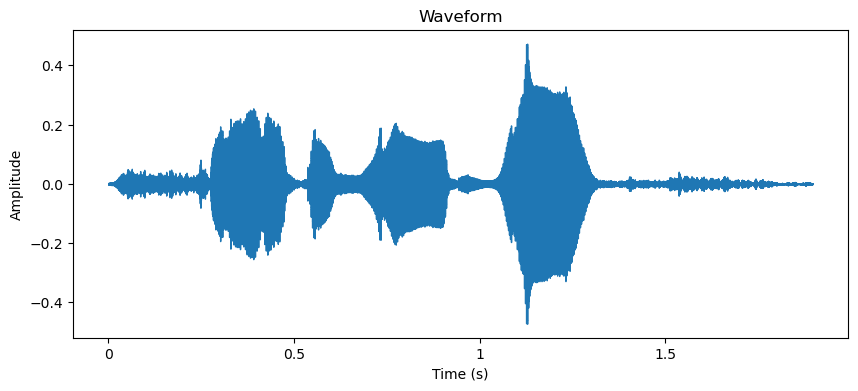

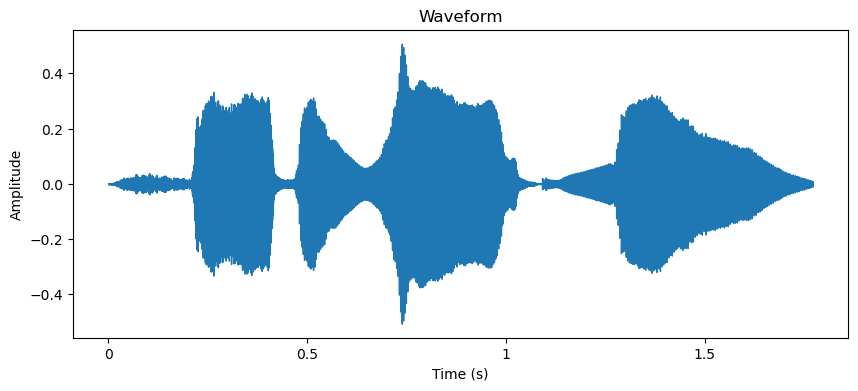

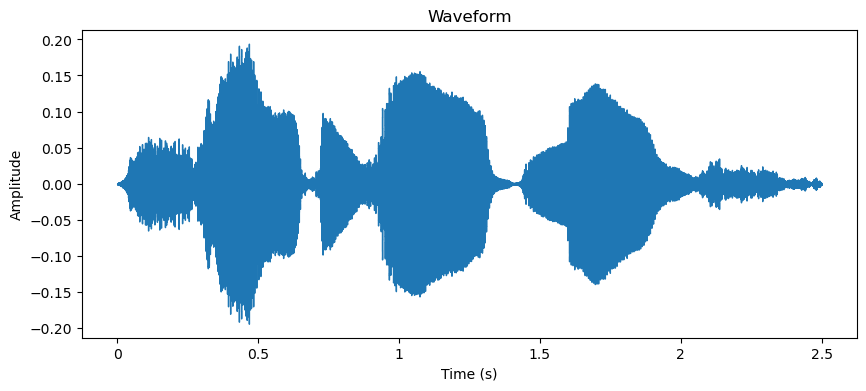

AttributeError: module 'matplotlib' has no attribute 'pyplot'

In [88]:
plotAmplitude(sadTrainSample, sadTrainDir)

In [89]:
# STEP 3: ACOUSTIC FEATURE EXTRACTION

In [102]:
def printExtractedFeatures(audio_dataset, path):   
    for audio in audio_dataset:
        file_path = os.path.join(path, audio)
        
        # load the audio file
        audio_data, sample_rate = librosa.load(file_path)
        
        # extract the Mel-frequency cepstral coefficients (MFCCs)
        mfccs = librosa.feature.mfcc(y=audio_data, sr=sample_rate, n_mfcc=13)

        # extract the spectral centroid
        spectral_centroid = librosa.feature.spectral_centroid(y=audio_data, sr=sample_rate)

        # extract the zero-crossing rate
        zcr = librosa.feature.zero_crossing_rate(y=audio_data)

        # extract the root-mean-square (RMS) energy
        rms = librosa.feature.rms(y=audio_data)
    
        # extract the spectral rolloff
        spectral_rolloff = librosa.feature.spectral_rolloff(y=audio_data, sr=sample_rate)

        # extract the spectral bandwidth
        spectral_bandwidth = librosa.feature.spectral_bandwidth(y=audio_data, sr=sample_rate)

        # print the shapes of the extracted features
        print(f"MFCCs shape: {mfccs.shape}")
        print(f"Spectral centroid shape: {spectral_centroid.shape}")
        print(f"Zero-crossing rate shape: {zcr.shape}")
        print(f"RMS shape: {rms.shape}")
        print(f"Spectral rolloff shape: {spectral_rolloff.shape}")
        print(f"Spectral bandwidth shape: {spectral_bandwidth.shape}")
        print("\n")

In [103]:
angryTrain = random.sample(os.listdir(angryTrainDir), 70)
angryTest = random.sample(os.listdir(angryTestDir), 30) 

fearTrain = random.sample(os.listdir(fearTrainDir), 70)
fearTest = random.sample(os.listdir(fearTestDir), 30) 

happyTrain = random.sample(os.listdir(happyTrainDir), 70)
happyTest = random.sample(os.listdir(happyTestDir), 30) 

sadTrain = random.sample(os.listdir(sadTrainDir), 70)
sadTest = random.sample(os.listdir(sadTestDir), 30)

In [104]:
printExtractedFeatures(angryTrain, angryTrainDir)

MFCCs shape: (13, 86)
Spectral centroid shape: (1, 86)
Zero-crossing rate shape: (1, 86)
RMS shape: (1, 86)
Spectral rolloff shape: (1, 86)
Spectral bandwidth shape: (1, 86)


MFCCs shape: (13, 98)
Spectral centroid shape: (1, 98)
Zero-crossing rate shape: (1, 98)
RMS shape: (1, 98)
Spectral rolloff shape: (1, 98)
Spectral bandwidth shape: (1, 98)


MFCCs shape: (13, 96)
Spectral centroid shape: (1, 96)
Zero-crossing rate shape: (1, 96)
RMS shape: (1, 96)
Spectral rolloff shape: (1, 96)
Spectral bandwidth shape: (1, 96)


MFCCs shape: (13, 84)
Spectral centroid shape: (1, 84)
Zero-crossing rate shape: (1, 84)
RMS shape: (1, 84)
Spectral rolloff shape: (1, 84)
Spectral bandwidth shape: (1, 84)


MFCCs shape: (13, 90)
Spectral centroid shape: (1, 90)
Zero-crossing rate shape: (1, 90)
RMS shape: (1, 90)
Spectral rolloff shape: (1, 90)
Spectral bandwidth shape: (1, 90)


MFCCs shape: (13, 92)
Spectral centroid shape: (1, 92)
Zero-crossing rate shape: (1, 92)
RMS shape: (1, 92)
Spectral rol

MFCCs shape: (13, 88)
Spectral centroid shape: (1, 88)
Zero-crossing rate shape: (1, 88)
RMS shape: (1, 88)
Spectral rolloff shape: (1, 88)
Spectral bandwidth shape: (1, 88)


MFCCs shape: (13, 88)
Spectral centroid shape: (1, 88)
Zero-crossing rate shape: (1, 88)
RMS shape: (1, 88)
Spectral rolloff shape: (1, 88)
Spectral bandwidth shape: (1, 88)


MFCCs shape: (13, 89)
Spectral centroid shape: (1, 89)
Zero-crossing rate shape: (1, 89)
RMS shape: (1, 89)
Spectral rolloff shape: (1, 89)
Spectral bandwidth shape: (1, 89)


MFCCs shape: (13, 96)
Spectral centroid shape: (1, 96)
Zero-crossing rate shape: (1, 96)
RMS shape: (1, 96)
Spectral rolloff shape: (1, 96)
Spectral bandwidth shape: (1, 96)


MFCCs shape: (13, 103)
Spectral centroid shape: (1, 103)
Zero-crossing rate shape: (1, 103)
RMS shape: (1, 103)
Spectral rolloff shape: (1, 103)
Spectral bandwidth shape: (1, 103)


MFCCs shape: (13, 90)
Spectral centroid shape: (1, 90)
Zero-crossing rate shape: (1, 90)
RMS shape: (1, 90)
Spectr

In [105]:
printExtractedFeatures(fearTrain, fearTrainDir)

MFCCs shape: (13, 73)
Spectral centroid shape: (1, 73)
Zero-crossing rate shape: (1, 73)
RMS shape: (1, 73)
Spectral rolloff shape: (1, 73)
Spectral bandwidth shape: (1, 73)


MFCCs shape: (13, 77)
Spectral centroid shape: (1, 77)
Zero-crossing rate shape: (1, 77)
RMS shape: (1, 77)
Spectral rolloff shape: (1, 77)
Spectral bandwidth shape: (1, 77)


MFCCs shape: (13, 75)
Spectral centroid shape: (1, 75)
Zero-crossing rate shape: (1, 75)
RMS shape: (1, 75)
Spectral rolloff shape: (1, 75)
Spectral bandwidth shape: (1, 75)


MFCCs shape: (13, 77)
Spectral centroid shape: (1, 77)
Zero-crossing rate shape: (1, 77)
RMS shape: (1, 77)
Spectral rolloff shape: (1, 77)
Spectral bandwidth shape: (1, 77)


MFCCs shape: (13, 74)
Spectral centroid shape: (1, 74)
Zero-crossing rate shape: (1, 74)
RMS shape: (1, 74)
Spectral rolloff shape: (1, 74)
Spectral bandwidth shape: (1, 74)


MFCCs shape: (13, 80)
Spectral centroid shape: (1, 80)
Zero-crossing rate shape: (1, 80)
RMS shape: (1, 80)
Spectral rol

MFCCs shape: (13, 76)
Spectral centroid shape: (1, 76)
Zero-crossing rate shape: (1, 76)
RMS shape: (1, 76)
Spectral rolloff shape: (1, 76)
Spectral bandwidth shape: (1, 76)


MFCCs shape: (13, 82)
Spectral centroid shape: (1, 82)
Zero-crossing rate shape: (1, 82)
RMS shape: (1, 82)
Spectral rolloff shape: (1, 82)
Spectral bandwidth shape: (1, 82)


MFCCs shape: (13, 73)
Spectral centroid shape: (1, 73)
Zero-crossing rate shape: (1, 73)
RMS shape: (1, 73)
Spectral rolloff shape: (1, 73)
Spectral bandwidth shape: (1, 73)


MFCCs shape: (13, 76)
Spectral centroid shape: (1, 76)
Zero-crossing rate shape: (1, 76)
RMS shape: (1, 76)
Spectral rolloff shape: (1, 76)
Spectral bandwidth shape: (1, 76)


MFCCs shape: (13, 79)
Spectral centroid shape: (1, 79)
Zero-crossing rate shape: (1, 79)
RMS shape: (1, 79)
Spectral rolloff shape: (1, 79)
Spectral bandwidth shape: (1, 79)


MFCCs shape: (13, 77)
Spectral centroid shape: (1, 77)
Zero-crossing rate shape: (1, 77)
RMS shape: (1, 77)
Spectral rol

In [106]:
printExtractedFeatures(happyTrain, happyTrainDir)

MFCCs shape: (13, 94)
Spectral centroid shape: (1, 94)
Zero-crossing rate shape: (1, 94)
RMS shape: (1, 94)
Spectral rolloff shape: (1, 94)
Spectral bandwidth shape: (1, 94)


MFCCs shape: (13, 84)
Spectral centroid shape: (1, 84)
Zero-crossing rate shape: (1, 84)
RMS shape: (1, 84)
Spectral rolloff shape: (1, 84)
Spectral bandwidth shape: (1, 84)


MFCCs shape: (13, 80)
Spectral centroid shape: (1, 80)
Zero-crossing rate shape: (1, 80)
RMS shape: (1, 80)
Spectral rolloff shape: (1, 80)
Spectral bandwidth shape: (1, 80)


MFCCs shape: (13, 88)
Spectral centroid shape: (1, 88)
Zero-crossing rate shape: (1, 88)
RMS shape: (1, 88)
Spectral rolloff shape: (1, 88)
Spectral bandwidth shape: (1, 88)


MFCCs shape: (13, 76)
Spectral centroid shape: (1, 76)
Zero-crossing rate shape: (1, 76)
RMS shape: (1, 76)
Spectral rolloff shape: (1, 76)
Spectral bandwidth shape: (1, 76)


MFCCs shape: (13, 81)
Spectral centroid shape: (1, 81)
Zero-crossing rate shape: (1, 81)
RMS shape: (1, 81)
Spectral rol

MFCCs shape: (13, 87)
Spectral centroid shape: (1, 87)
Zero-crossing rate shape: (1, 87)
RMS shape: (1, 87)
Spectral rolloff shape: (1, 87)
Spectral bandwidth shape: (1, 87)


MFCCs shape: (13, 91)
Spectral centroid shape: (1, 91)
Zero-crossing rate shape: (1, 91)
RMS shape: (1, 91)
Spectral rolloff shape: (1, 91)
Spectral bandwidth shape: (1, 91)


MFCCs shape: (13, 88)
Spectral centroid shape: (1, 88)
Zero-crossing rate shape: (1, 88)
RMS shape: (1, 88)
Spectral rolloff shape: (1, 88)
Spectral bandwidth shape: (1, 88)


MFCCs shape: (13, 90)
Spectral centroid shape: (1, 90)
Zero-crossing rate shape: (1, 90)
RMS shape: (1, 90)
Spectral rolloff shape: (1, 90)
Spectral bandwidth shape: (1, 90)


MFCCs shape: (13, 90)
Spectral centroid shape: (1, 90)
Zero-crossing rate shape: (1, 90)
RMS shape: (1, 90)
Spectral rolloff shape: (1, 90)
Spectral bandwidth shape: (1, 90)


MFCCs shape: (13, 79)
Spectral centroid shape: (1, 79)
Zero-crossing rate shape: (1, 79)
RMS shape: (1, 79)
Spectral rol

In [107]:
printExtractedFeatures(sadTrain, sadTrainDir)

MFCCs shape: (13, 98)
Spectral centroid shape: (1, 98)
Zero-crossing rate shape: (1, 98)
RMS shape: (1, 98)
Spectral rolloff shape: (1, 98)
Spectral bandwidth shape: (1, 98)


MFCCs shape: (13, 98)
Spectral centroid shape: (1, 98)
Zero-crossing rate shape: (1, 98)
RMS shape: (1, 98)
Spectral rolloff shape: (1, 98)
Spectral bandwidth shape: (1, 98)


MFCCs shape: (13, 100)
Spectral centroid shape: (1, 100)
Zero-crossing rate shape: (1, 100)
RMS shape: (1, 100)
Spectral rolloff shape: (1, 100)
Spectral bandwidth shape: (1, 100)


MFCCs shape: (13, 93)
Spectral centroid shape: (1, 93)
Zero-crossing rate shape: (1, 93)
RMS shape: (1, 93)
Spectral rolloff shape: (1, 93)
Spectral bandwidth shape: (1, 93)


MFCCs shape: (13, 90)
Spectral centroid shape: (1, 90)
Zero-crossing rate shape: (1, 90)
RMS shape: (1, 90)
Spectral rolloff shape: (1, 90)
Spectral bandwidth shape: (1, 90)


MFCCs shape: (13, 96)
Spectral centroid shape: (1, 96)
Zero-crossing rate shape: (1, 96)
RMS shape: (1, 96)
Spectr

MFCCs shape: (13, 91)
Spectral centroid shape: (1, 91)
Zero-crossing rate shape: (1, 91)
RMS shape: (1, 91)
Spectral rolloff shape: (1, 91)
Spectral bandwidth shape: (1, 91)


MFCCs shape: (13, 89)
Spectral centroid shape: (1, 89)
Zero-crossing rate shape: (1, 89)
RMS shape: (1, 89)
Spectral rolloff shape: (1, 89)
Spectral bandwidth shape: (1, 89)


MFCCs shape: (13, 98)
Spectral centroid shape: (1, 98)
Zero-crossing rate shape: (1, 98)
RMS shape: (1, 98)
Spectral rolloff shape: (1, 98)
Spectral bandwidth shape: (1, 98)


MFCCs shape: (13, 95)
Spectral centroid shape: (1, 95)
Zero-crossing rate shape: (1, 95)
RMS shape: (1, 95)
Spectral rolloff shape: (1, 95)
Spectral bandwidth shape: (1, 95)


MFCCs shape: (13, 95)
Spectral centroid shape: (1, 95)
Zero-crossing rate shape: (1, 95)
RMS shape: (1, 95)
Spectral rolloff shape: (1, 95)
Spectral bandwidth shape: (1, 95)


MFCCs shape: (13, 101)
Spectral centroid shape: (1, 101)
Zero-crossing rate shape: (1, 101)
RMS shape: (1, 101)
Spectral

In [108]:
# STEP 4: FEATURE POST-PROCESSING

In [109]:
import numpy as np
from sklearn.preprocessing import MinMaxScaler

In [117]:
# define the time window for feature averaging (in seconds)
window_size = 0.1

# define the number of MFCCs to extract
n_mfcc = 13

# define an empty list to store the features for each audio file
angry_features_list = []

In [114]:
def getFeatPost(features_list, audio_dataset, audio_dir):
    # loop through each audio file in the directory
    for filename in audio_dataset:
        # load the audio file
        audio_file = os.path.join(audio_dir, filename)
        audio_data, sample_rate = librosa.load(audio_file)
        
        # extract the Mel-frequency cepstral coefficients (MFCCs)
        mfccs = librosa.feature.mfcc(y=audio_data, sr=sample_rate, n_mfcc=n_mfcc)

        # extract the spectral centroid
        spectral_centroid = librosa.feature.spectral_centroid(y=audio_data, sr=sample_rate)

        # extract the zero-crossing rate
        zcr = librosa.feature.zero_crossing_rate(y=audio_data)

        # extract the root-mean-square (RMS) energy
        rms = librosa.feature.rms(y=audio_data)

        # extract the spectral rolloff
        spectral_rolloff = librosa.feature.spectral_rolloff(y=audio_data, sr=sample_rate)

        # extract the spectral bandwidth
        spectral_bandwidth = librosa.feature.spectral_bandwidth(y=audio_data, sr=sample_rate)

        # concatenate the features into a single feature vector
        features = np.concatenate((mfccs, spectral_centroid, zcr, rms, spectral_rolloff, spectral_bandwidth))

        # scale the features to the range [-1, 1]
        scaler = MinMaxScaler(feature_range=(-1, 1))
        scaled_features = scaler.fit_transform(features)

        # determine the number of frames in the audio file
        num_frames = int(len(audio_data) / (sample_rate * window_size))

        # create an empty list to store the averaged features for each frame
        averaged_features = []

        # loop through each frame and average the features within the time window
        for i in range(num_frames):
            start = int(i * sample_rate * window_size)
            end = int((i + 1) * sample_rate * window_size)
            frame_features = scaled_features[:, start:end]
            frame_averages = np.mean(frame_features, axis=1)
            averaged_features.append(frame_averages)

        # convert the averaged features to a numpy array and add to the list of features
        features_list.append(np.array(averaged_features))
        
        return features_list

In [118]:
angry_features_list = getFeatPost(angry_features_list, angryTrain, angryTrainDir)

/Users/julia/anaconda3/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3432: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/Users/julia/anaconda3/lib/python3.10/site-packages/numpy/core/_methods.py:182: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(


In [119]:
# convert the list of features to a numpy array
angry_feature_matrix = np.concatenate(angry_features_list)

# print the shape of the feature matrix
print(f"Feature matrix shape: {angry_feature_matrix.shape}")

Feature matrix shape: (19, 18)


In [120]:
fear_features_list = []
fear_features_list = getFeatPost(fear_features_list, fearTrain, fearTrainDir)
fear_feature_matrix = np.concatenate(fear_features_list)
print(f"Feature matrix shape: {fear_feature_matrix.shape}")

Feature matrix shape: (16, 18)


/Users/julia/anaconda3/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3432: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/Users/julia/anaconda3/lib/python3.10/site-packages/numpy/core/_methods.py:182: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(


In [121]:
happy_features_list = []
happy_features_list = getFeatPost(happy_features_list, happyTrain, happyTrainDir)
happy_feature_matrix = np.concatenate(happy_features_list)
print(f"Feature matrix shape: {happy_feature_matrix.shape}")

Feature matrix shape: (21, 18)


/Users/julia/anaconda3/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3432: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/Users/julia/anaconda3/lib/python3.10/site-packages/numpy/core/_methods.py:182: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(


In [122]:
sad_features_list = []
sad_features_list = getFeatPost(sad_features_list, sadTrain, sadTrainDir)
sad_feature_matrix = np.concatenate(sad_features_list)
print(f"Feature matrix shape: {sad_feature_matrix.shape}")

Feature matrix shape: (22, 18)


/Users/julia/anaconda3/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3432: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/Users/julia/anaconda3/lib/python3.10/site-packages/numpy/core/_methods.py:182: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(


In [202]:
# STEP 5: AUDIO RECOGNITION MODEL

In [203]:
import librosa
import numpy as np
import pandas as pd
import os
import glob
import warnings
from sklearn.model_selection import train_test_split
warnings.filterwarnings('ignore')

In [204]:
def extract_features(file_name):
    # Load audio file
    audio_data, audio_sr = librosa.load(file_name)
    
    # Extract features
    mfccs = librosa.feature.mfcc(y=audio_data, sr=audio_sr, n_mfcc=40)
    chroma = librosa.feature.chroma_stft(y=audio_data, sr=audio_sr)
    mel = librosa.feature.melspectrogram(y=audio_data, sr=audio_sr)
    contrast = librosa.feature.spectral_contrast(y=audio_data, sr=audio_sr)
    tonnetz = librosa.feature.tonnetz(y=audio_data, sr=audio_sr)
    
    # Concatenate all features into one array
    features = np.concatenate((mfccs.mean(axis=1), 
                               chroma.mean(axis=1), 
                               mel.mean(axis=1), 
                               contrast.mean(axis=1), 
                               tonnetz.mean(axis=1)))
    
    # Scale the features
    scaled_features = (features - np.mean(features)) / np.std(features)
    
    return scaled_features


In [205]:
# Load the training data and extract features
train_data = pd.DataFrame(columns=['feature'])
train_labels = []

emotions = ['angry', 'happy', 'sad', 'fear']

In [206]:
for emotion in emotions:
    emotionDir = os.path.join(dataDir, emotion)
    files = os.listdir(emotionDir)
    trainFiles = random.sample(files, 70)
    
    for file_name in trainFiles:
        audio_file = os.path.join(emotionDir, file_name)
        print(audio_file)

/Users/julia/cis4930-mulitmodal-ml/hw3/data/angry/YAF_rush_angry.wav
/Users/julia/cis4930-mulitmodal-ml/hw3/data/angry/YAF_mode_angry.wav
/Users/julia/cis4930-mulitmodal-ml/hw3/data/angry/YAF_thought_angry.wav
/Users/julia/cis4930-mulitmodal-ml/hw3/data/angry/YAF_shout_angry.wav
/Users/julia/cis4930-mulitmodal-ml/hw3/data/angry/YAF_rose_angry.wav
/Users/julia/cis4930-mulitmodal-ml/hw3/data/angry/YAF_pool_angry.wav
/Users/julia/cis4930-mulitmodal-ml/hw3/data/angry/YAF_sure_angry.wav
/Users/julia/cis4930-mulitmodal-ml/hw3/data/angry/YAF_pad_angry.wav
/Users/julia/cis4930-mulitmodal-ml/hw3/data/angry/YAF_said_angry.wav
/Users/julia/cis4930-mulitmodal-ml/hw3/data/angry/YAF_rag_angry.wav
/Users/julia/cis4930-mulitmodal-ml/hw3/data/angry/YAF_reach_angry.wav
/Users/julia/cis4930-mulitmodal-ml/hw3/data/angry/YAF_sour_angry.wav
/Users/julia/cis4930-mulitmodal-ml/hw3/data/angry/YAF_shall_angry.wav
/Users/julia/cis4930-mulitmodal-ml/hw3/data/angry/YAF_pike_angry.wav
/Users/julia/cis4930-mulitmoda

In [207]:
for emotion in emotions:
    emotionDir = os.path.join(dataDir, emotion)
    files = os.listdir(emotionDir)
    trainFiles = random.sample(files, 70)
    
    for file_name in trainFiles:
        emotion_label = emotions.index(emotion)
        audio_file = os.path.join(emotionDir, file_name)
        features = extract_features(audio_file)
        train_data = train_data.append({'feature': features}, ignore_index=True)
        train_labels.append(emotion_label)

In [208]:
# Convert features and labels to numpy arrays
X_train = np.array(train_data['feature'].tolist())
y_train = np.array(train_labels)

In [209]:
# Load the test data and extract features
test_data = pd.DataFrame(columns=['feature'])
test_labels = []

In [210]:
for emotion in emotions:
    emotionDir = os.path.join(dataDir, emotion)
    files = os.listdir(emotionDir)
    testFiles = random.sample(files, 30)
    
    for file_name in testFiles:
        emotion_label = emotions.index(emotion)
        audio_file = os.path.join(emotionDir, file_name)
        features = extract_features(audio_file)
        test_data = test_data.append({'feature': features}, ignore_index=True)
        test_labels.append(emotion_label)
        
    print(len(testFiles))

30
30
30
30


In [211]:
count = 0

for emotion in emotions:
    emotionDir = os.path.join(dataDir, emotion)
    files = os.listdir(emotionDir)
    testFiles = random.sample(files, 30)
    
    for file_name in testFiles:
        audio_file = os.path.join(emotionDir, file_name)
        count += 1
        print(audio_file)
        
print(count)   

/Users/julia/cis4930-mulitmodal-ml/hw3/data/angry/YAF_mob_angry.wav
/Users/julia/cis4930-mulitmodal-ml/hw3/data/angry/YAF_ring_angry.wav
/Users/julia/cis4930-mulitmodal-ml/hw3/data/angry/YAF_pad_angry.wav
/Users/julia/cis4930-mulitmodal-ml/hw3/data/angry/YAF_room_angry.wav
/Users/julia/cis4930-mulitmodal-ml/hw3/data/angry/YAF_third_angry.wav
/Users/julia/cis4930-mulitmodal-ml/hw3/data/angry/YAF_sell_angry.wav
/Users/julia/cis4930-mulitmodal-ml/hw3/data/angry/YAF_puff_angry.wav
/Users/julia/cis4930-mulitmodal-ml/hw3/data/angry/YAF_tough_angry.wav
/Users/julia/cis4930-mulitmodal-ml/hw3/data/angry/YAF_road_angry.wav
/Users/julia/cis4930-mulitmodal-ml/hw3/data/angry/YAF_raise_angry.wav
/Users/julia/cis4930-mulitmodal-ml/hw3/data/angry/YAF_pool_angry.wav
/Users/julia/cis4930-mulitmodal-ml/hw3/data/angry/YAF_met_angry.wav
/Users/julia/cis4930-mulitmodal-ml/hw3/data/angry/YAF_such_angry.wav
/Users/julia/cis4930-mulitmodal-ml/hw3/data/angry/YAF_week_angry.wav
/Users/julia/cis4930-mulitmodal-ml

In [212]:
# Convert features and labels to numpy arrays
X_test = np.array(test_data['feature'].tolist())
y_test = np.array(test_labels)

In [213]:
# Import the necessary libraries for building the model
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score

In [214]:
# Train a Random Forest Classifier
rfc = RandomForestClassifier(n_estimators=100)
rfc.fit(X_train, y_train)

RandomForestClassifier()

In [215]:
# Predict labels for the test data
y_pred = rfc.predict(X_test)

In [216]:
# Compute accuracy score
accuracy = accuracy_score(y_test, y_pred)
print(f'Accuracy: {accuracy}')

Accuracy: 1.0


In [217]:
print(len(X_train))

280


In [218]:
print(len(X_test))

120


In [219]:
print(f"Accuracy on test data: {accuracy:.2f}")

Accuracy on test data: 1.00
